## **Human Behaviour & Activity Analysis with an Inflated 3D CNN**


In [ ]:
from importHandler import *
logging.set_verbosity(logging.ERROR)

In [ ]:
ucfRoot, videoList, cacheDir = "https://www.crcv.ucf.edu/THUMOS14/UCF101/UCF101/", None, tempfile.mkdtemp()
unverifiedContext = ssl._create_unverified_context()

### **Data Section**

In [ ]:
def listUcfVideos():

    global videoList
    if not videoList:
        index  = request.urlopen(ucfRoot, context = unverifiedContext).read().decode("utf-8")
        videos = re.findall("(v_[\w_]+\.avi)", index)
        videoList = sorted(set(videos))

    return list(videoList)

In [ ]:
def fetchUcfVideo(video):

    cachePath = os.path.join(cacheDir, video)
    if not os.path.exists(cachePath):
        urlPath = request.urljoin(ucfRoot, video)
        print("Fetching %s => %s" % (urlPath, cachePath))

        data = request.urlopen(urlPath, context = unverifiedContext).read()
        open(cachePath, "wb").write(data)

    return cachePath

In [ ]:
def cropCenterSquare(frame):
    y, x = frame.shape[0:2]
    minDim = min(y, x)
    startX = (x // 2) - (minDim // 2)
    startY = (y // 2) - (minDim // 2)

    return frame[startY:startY + minDim, startX:startX + minDim]

In [ ]:
def loadVideo(path, maxFrames = 0, resize = (224, 224)):
    cap    = cv2.VideoCapture(path)
    frames = []
    try:
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            frame = cropCenterSquare(frame)
            frame = cv2.resize(frame, resize)
            frame = frame[:, :, [2, 1, 0]]
            frames.append(frame)

            if len(frames) == maxFrames:
                break
    finally:
        cap.release()

    return np.array(frames) / 255.0

In [ ]:
def toGif(images):

    convertedImages = np.clip(images * 255, 0, 255).astype(np.uint8)
    imageio.mimsave('./animation.gif', convertedImages, duration = 40)

    return embed.embed_file('./animation.gif')

In [ ]:
URL = "https://raw.githubusercontent.com/deepmind/kinetics-i3d/master/data/label_map.txt"

with request.urlopen(URL) as obj:
    labels = [line.decode("utf-8").strip() for line in obj.readlines()]

print("Found %d labels." % len(labels))

Found 400 labels.


In [ ]:
ucfVideos = listUcfVideos()

categories = {}
for video in ucfVideos:
    category = video[2: -12]
    if category not in categories:
        categories[category] = []
    categories[category].append(video)

print("Found %d videos in %d categories." % (len(ucfVideos), len(categories)))

Found 13320 videos in 101 categories.


## **Run the id3 model and print the top-2 action predictions.**

In [ ]:
i3d = hub.load("https://tfhub.dev/deepmind/i3d-kinetics-400/1").signatures['default']

In [ ]:
def loadVideoAndModel(inp: str, out: str):
    global model, cap, width, height, videoWriter

    model = YOLO('yolov8s.pt')
    cap   = cv2.VideoCapture(inp)
    assert cap.isOpened(), "Error reading video file"
    width, height, fps = (int(cap.get(x)) for x in (cv2.CAP_PROP_FRAME_WIDTH, cv2.CAP_PROP_FRAME_HEIGHT, cv2.CAP_PROP_FPS))

    videoWriter = cv2.VideoWriter(out, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

In [ ]:
def processVideoWithHeatmap(videoFile, outputFile, probs):
    loadVideoAndModel(videoFile, outputFile)

    heatmapObj = heatmap.Heatmap()
    heatmapObj.set_args(colormap = cv2.COLORMAP_PARULA, imw = width, imh = height, view_img = True, shape = "circle")

    while cap.isOpened():
        success, frame = cap.read()
        if not success:
            print("Video frame is empty or video processing has been successfully completed.")
            break

        tracks = model.track(frame, persist = True, show = False)
        frame  = heatmapObj.generate_heatmap(frame, tracks)

        yOffset = 30
        for label, probability in probs.items():
            text = f"{label}: {probability:.2f}%"
            textSize = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 1, 1)[0]
            cv2.rectangle(frame, (10, yOffset - textSize[1]), (10 + textSize[0], yOffset), (255, 255, 255), -1)
            cv2.putText(frame, text, (10, yOffset), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 1)
            yOffset += 31

        cv2.imshow('frame', frame)
        videoWriter.write(frame)

    cap.release()
    videoWriter.release()
    cv2.destroyAllWindows()

In [ ]:
videoPath = "walking.mp4"
sampleVideo = loadVideo(videoPath)[:100]
sampleVideo.shape

(100, 224, 224, 3)

In [ ]:
def predictAndAnalyseBehaviour(vid):
    modelInput = tf.constant(vid, dtype = tf.float32)[tf.newaxis, ...]

    logits        = i3d(modelInput)['default'][0]
    probabilities = tf.nn.softmax(logits)
    topLabelProbs = {}

    for i in np.argsort(probabilities)[::-1][:2]:
        label = labels[i]
        probability = probabilities[i] * 100
        topLabelProbs[label] = probability

    for label, probability in topLabelProbs.items():
        print(f"  {label:22}: {probability:5.2f}%")

    processVideoWithHeatmap('walking.mp4', 'walking-inf.mp4', topLabelProbs)

  marching              : 32.90%
  biking through snow   : 26.46%
WARNING ⚠️ Environment does not support cv2.imshow() or PIL Image.show()


0: 384x640 17 persons, 804.2ms
Speed: 3.4ms preprocess, 804.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


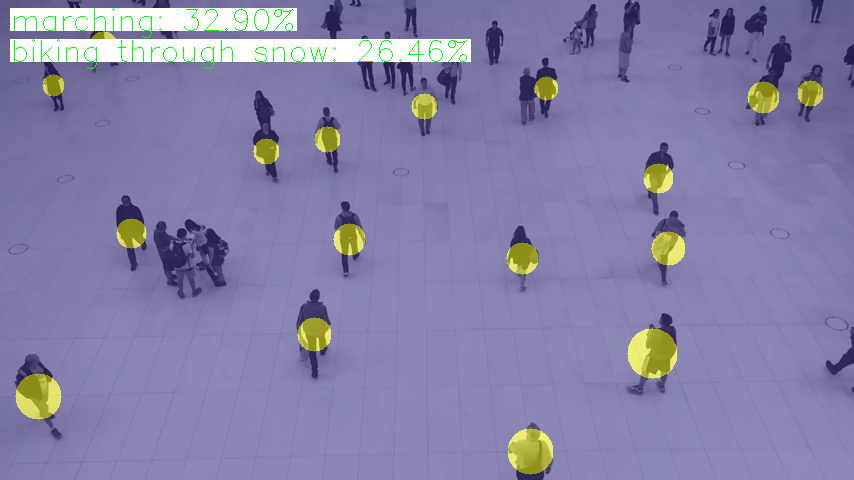


0: 384x640 17 persons, 807.2ms
Speed: 3.4ms preprocess, 807.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


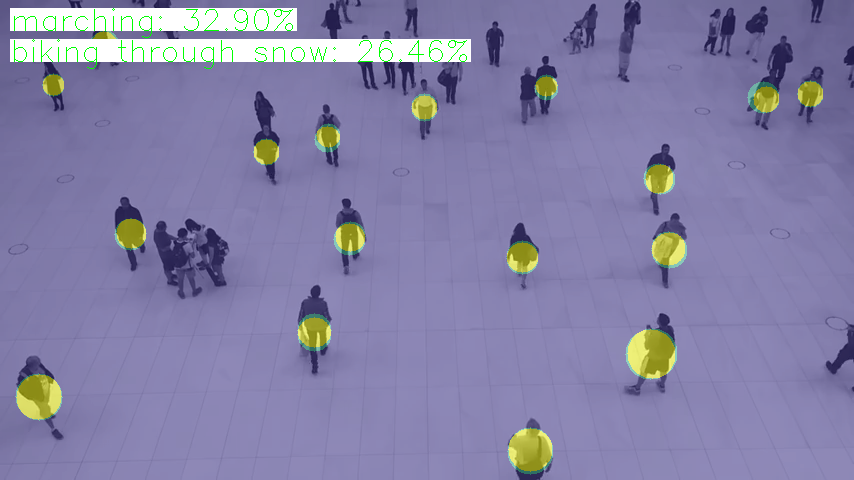


0: 384x640 17 persons, 385.5ms
Speed: 12.0ms preprocess, 385.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


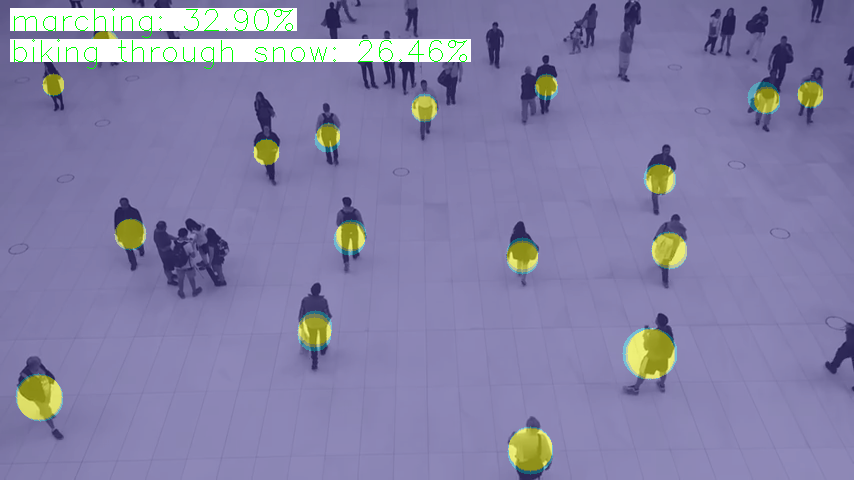


0: 384x640 17 persons, 441.0ms
Speed: 3.6ms preprocess, 441.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


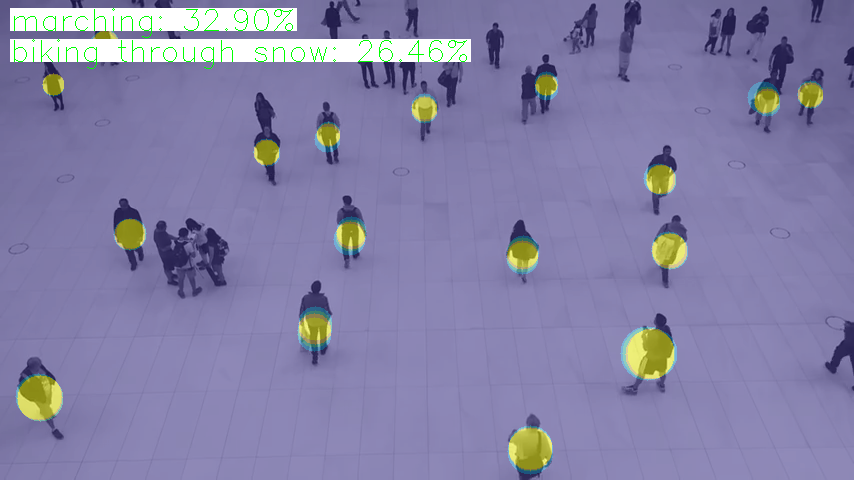


0: 384x640 18 persons, 406.7ms
Speed: 3.7ms preprocess, 406.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


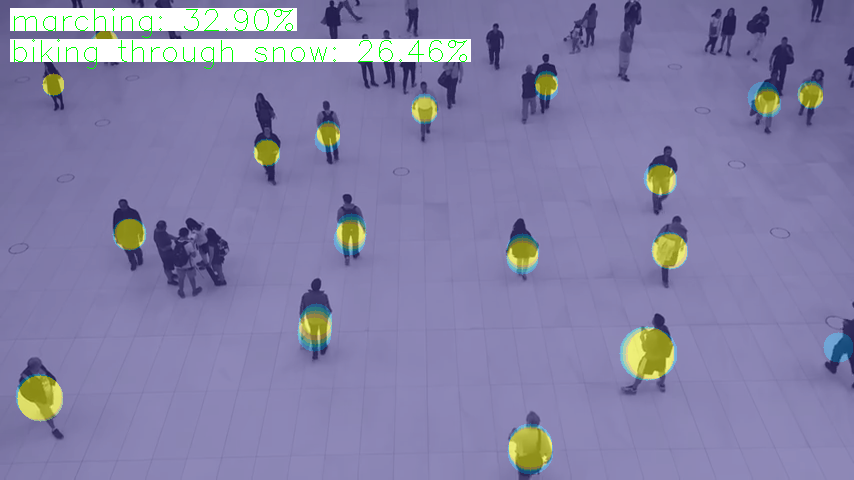


0: 384x640 18 persons, 407.4ms
Speed: 3.3ms preprocess, 407.4ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


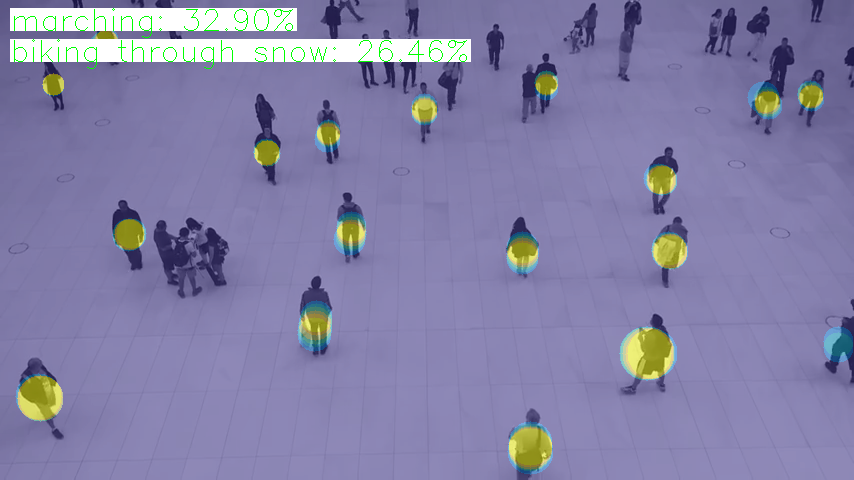


0: 384x640 18 persons, 403.3ms
Speed: 3.4ms preprocess, 403.3ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


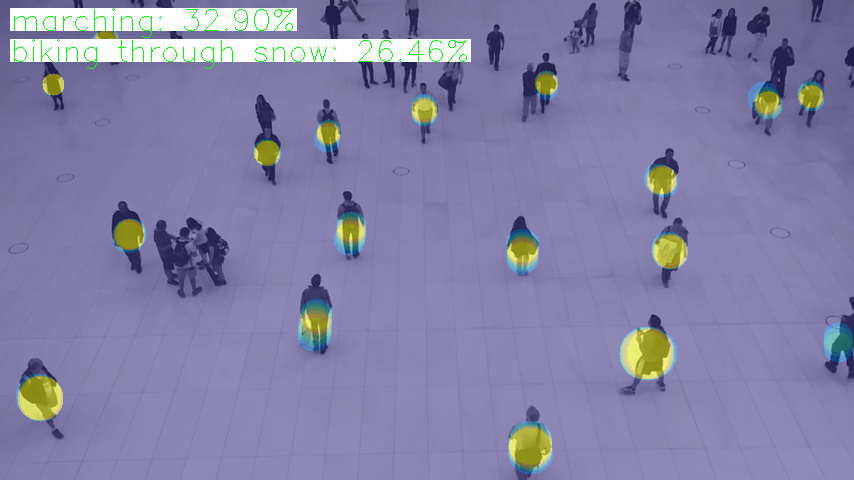


0: 384x640 18 persons, 429.0ms
Speed: 3.3ms preprocess, 429.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


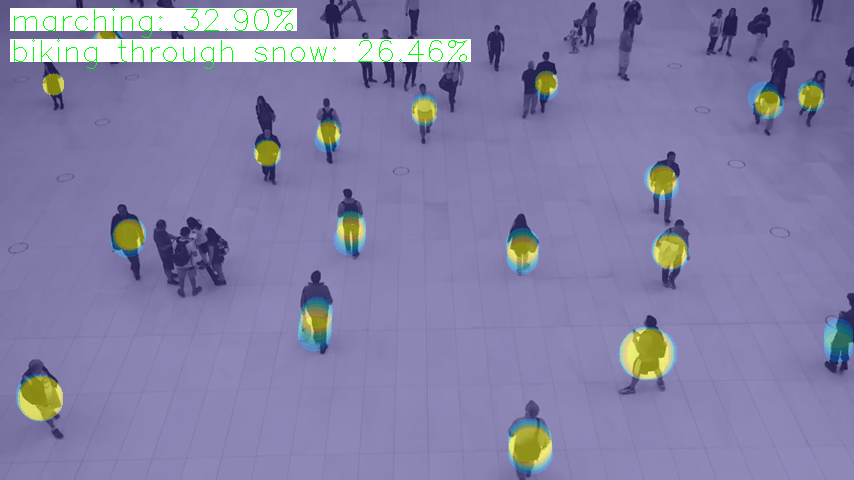


0: 384x640 19 persons, 429.2ms
Speed: 3.5ms preprocess, 429.2ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


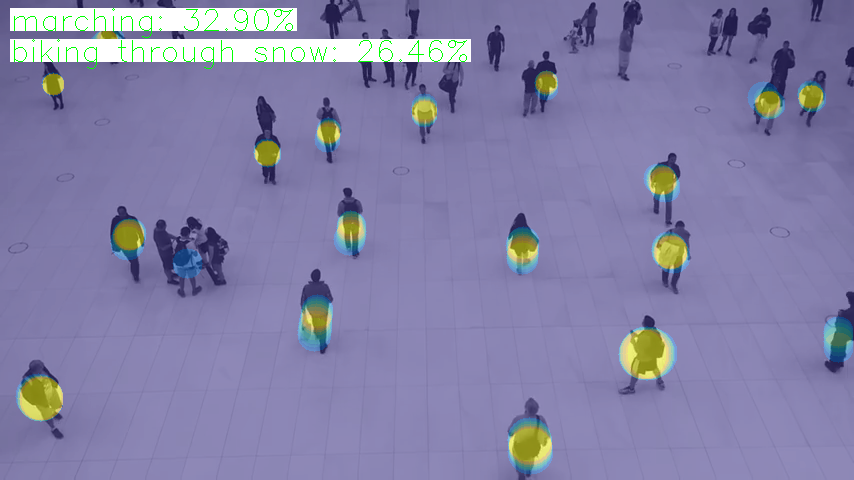


0: 384x640 19 persons, 416.8ms
Speed: 3.2ms preprocess, 416.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


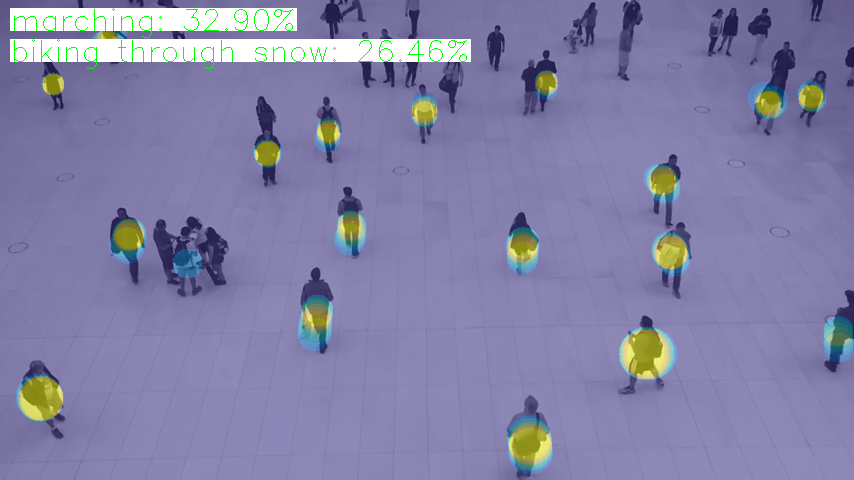


0: 384x640 19 persons, 419.2ms
Speed: 3.4ms preprocess, 419.2ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


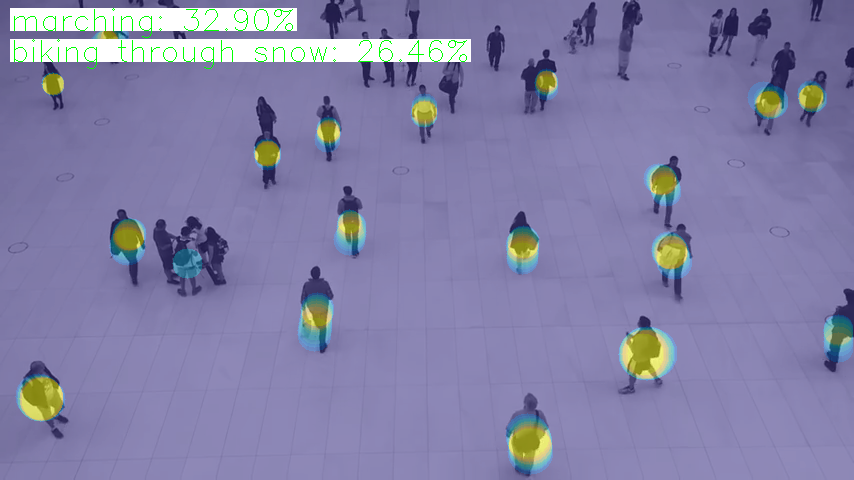


0: 384x640 19 persons, 431.0ms
Speed: 3.4ms preprocess, 431.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


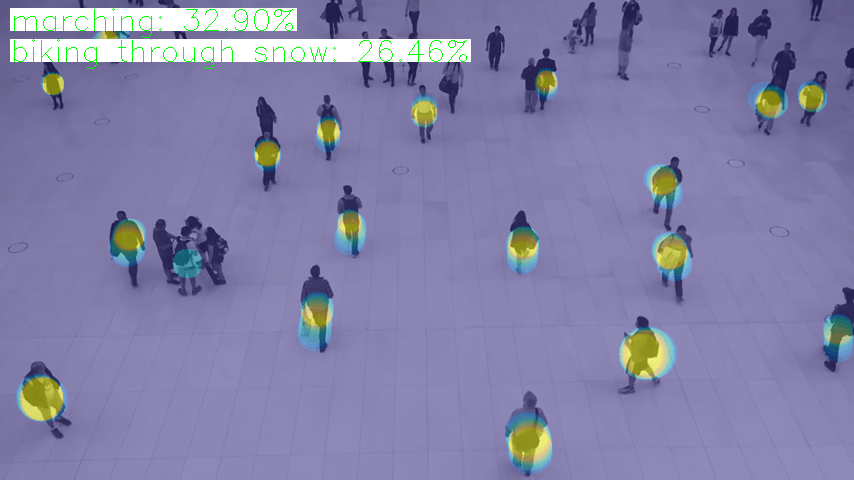


0: 384x640 19 persons, 435.9ms
Speed: 3.0ms preprocess, 435.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


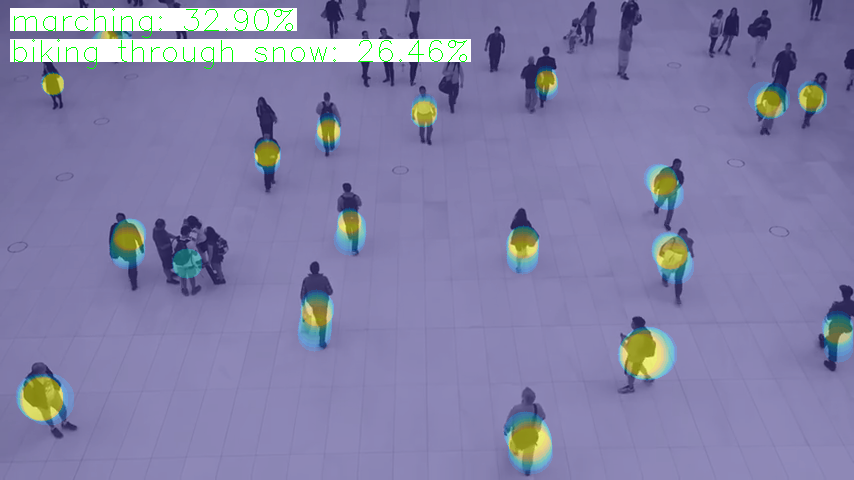


0: 384x640 19 persons, 610.2ms
Speed: 4.1ms preprocess, 610.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


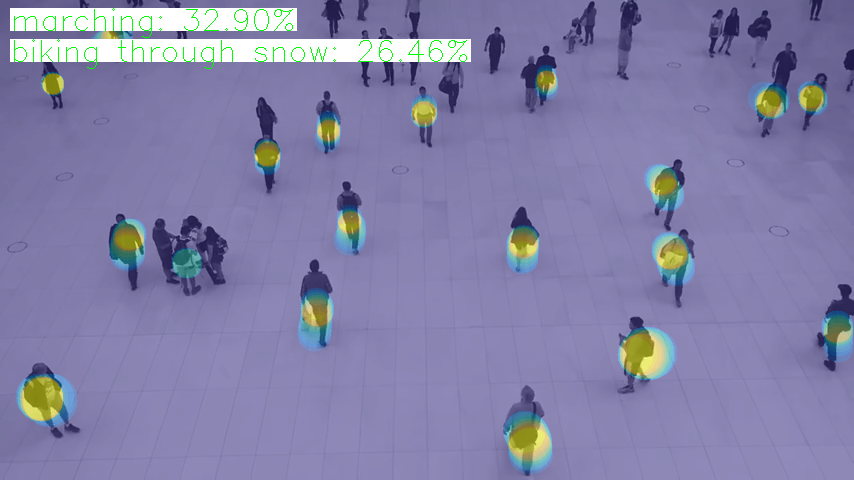


0: 384x640 19 persons, 625.7ms
Speed: 3.5ms preprocess, 625.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


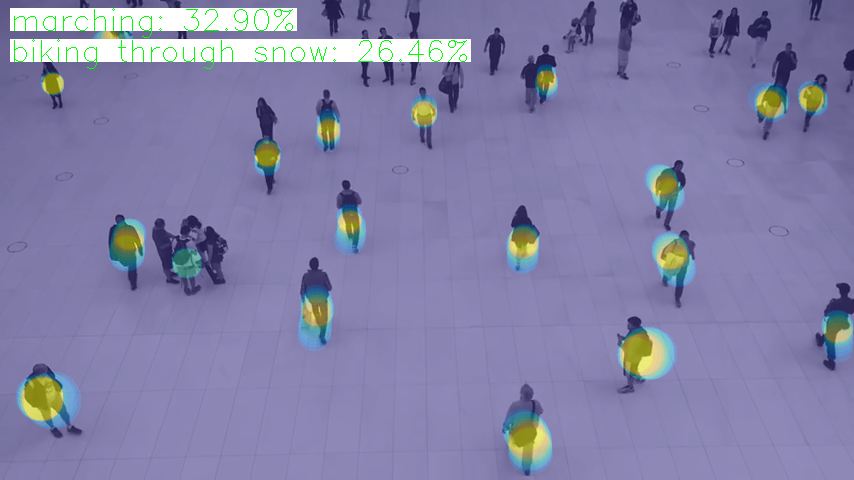


0: 384x640 19 persons, 639.0ms
Speed: 3.2ms preprocess, 639.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


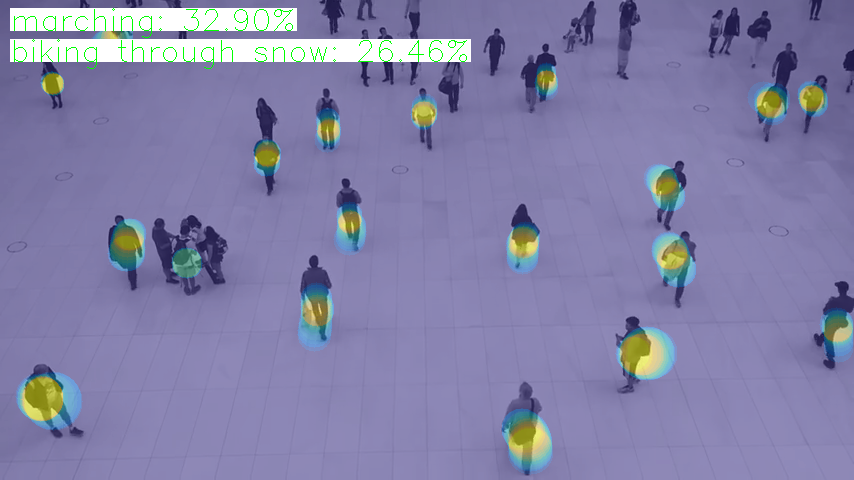


0: 384x640 19 persons, 593.8ms
Speed: 3.2ms preprocess, 593.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


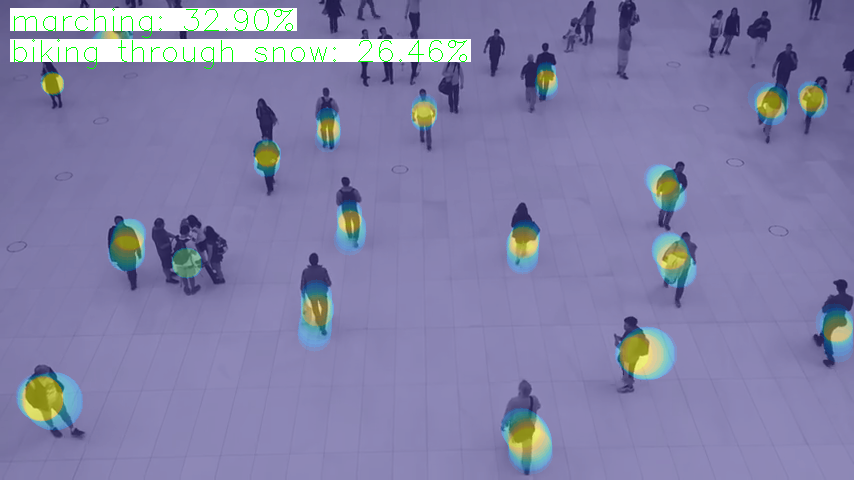


0: 384x640 19 persons, 616.7ms
Speed: 3.3ms preprocess, 616.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


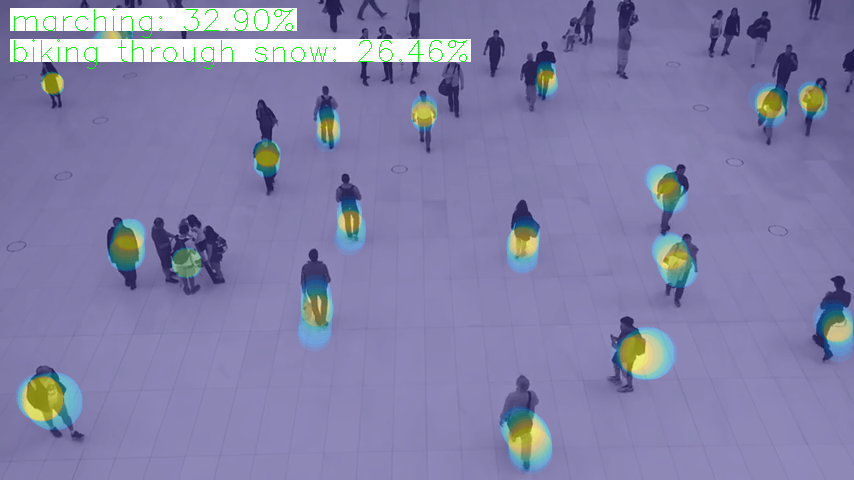


0: 384x640 19 persons, 700.0ms
Speed: 4.6ms preprocess, 700.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


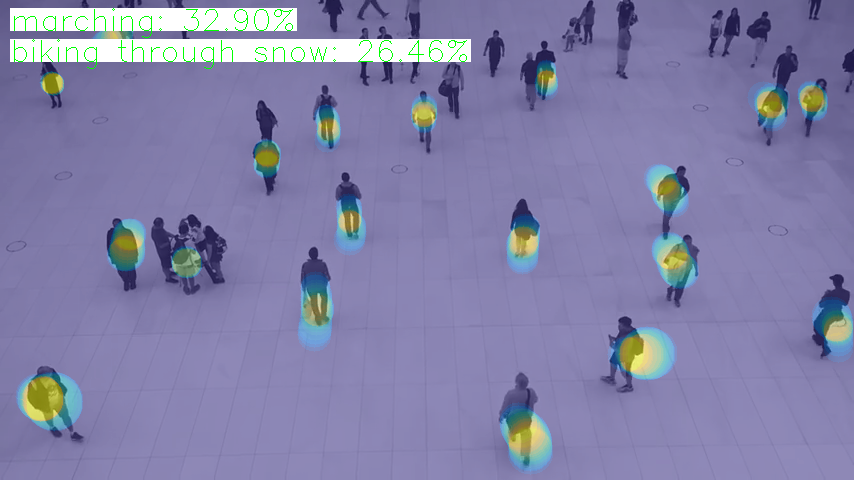


0: 384x640 19 persons, 475.8ms
Speed: 3.5ms preprocess, 475.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


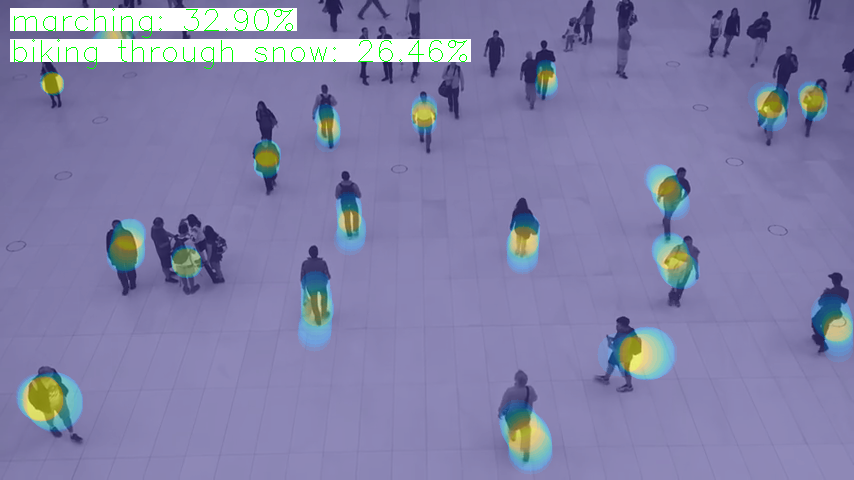


0: 384x640 19 persons, 475.3ms
Speed: 3.4ms preprocess, 475.3ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


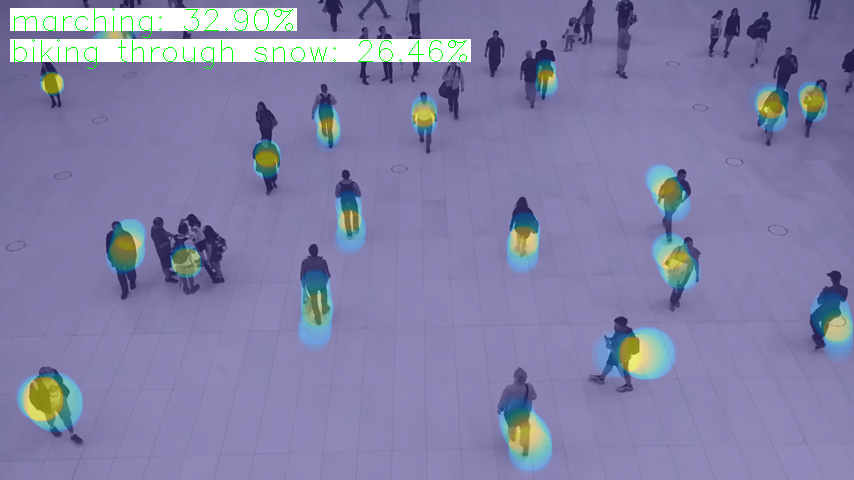


0: 384x640 19 persons, 516.3ms
Speed: 3.4ms preprocess, 516.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


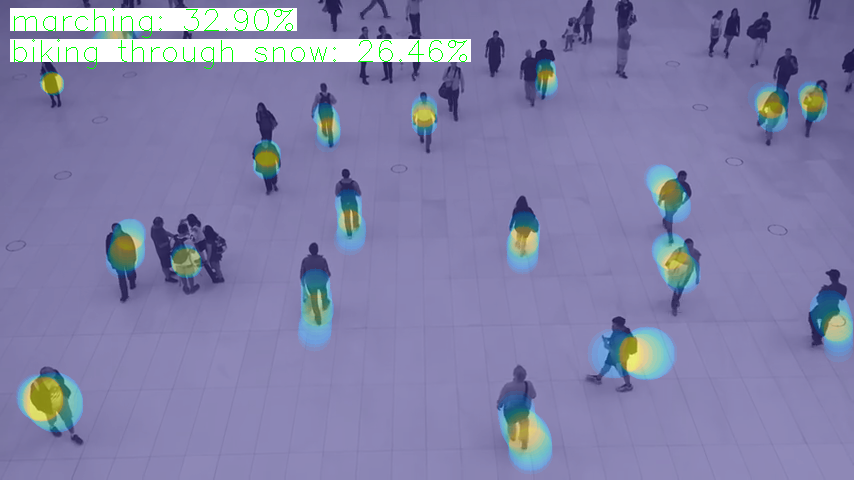


0: 384x640 19 persons, 482.8ms
Speed: 3.3ms preprocess, 482.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


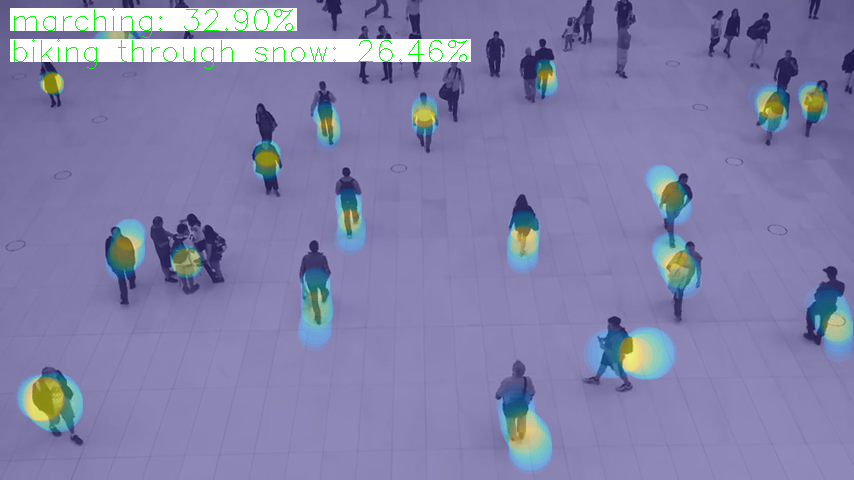


0: 384x640 19 persons, 518.6ms
Speed: 3.6ms preprocess, 518.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


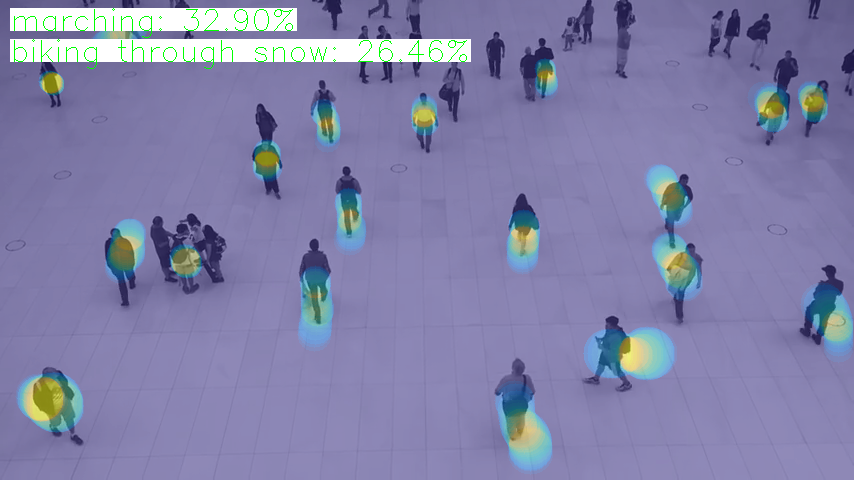


0: 384x640 19 persons, 533.5ms
Speed: 3.5ms preprocess, 533.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)


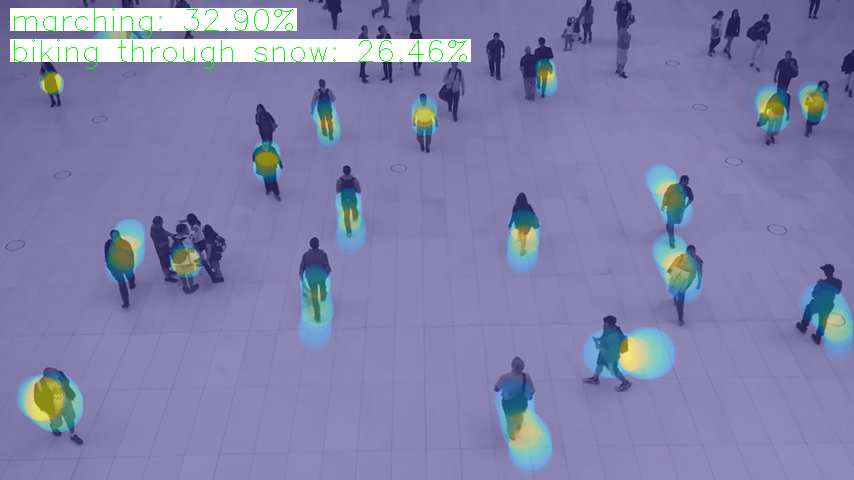


0: 384x640 19 persons, 514.7ms
Speed: 3.7ms preprocess, 514.7ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


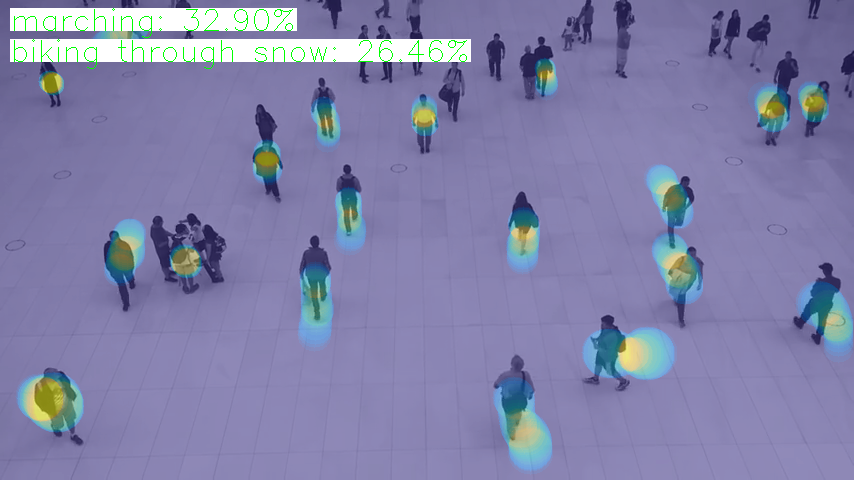


0: 384x640 19 persons, 590.5ms
Speed: 3.2ms preprocess, 590.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


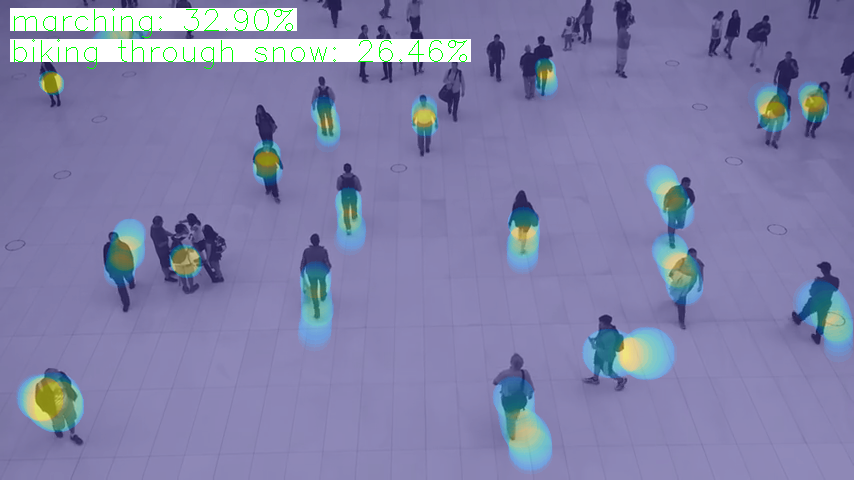


0: 384x640 19 persons, 568.5ms
Speed: 3.4ms preprocess, 568.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


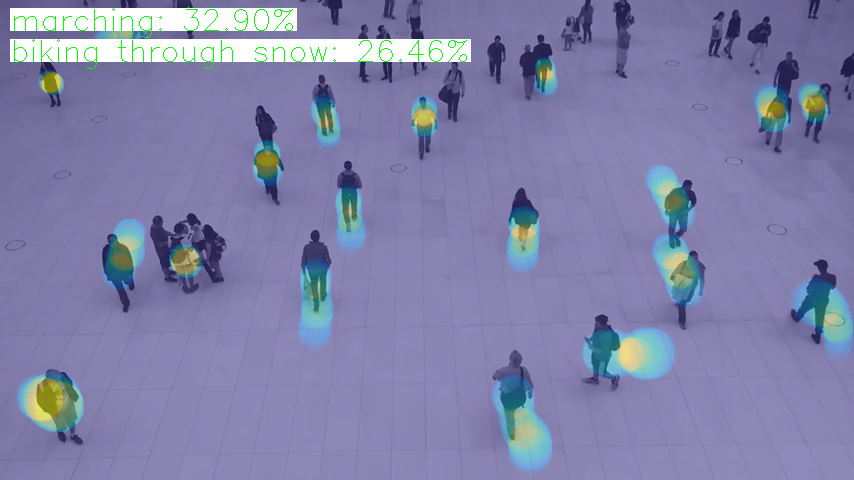


0: 384x640 19 persons, 537.0ms
Speed: 3.3ms preprocess, 537.0ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)


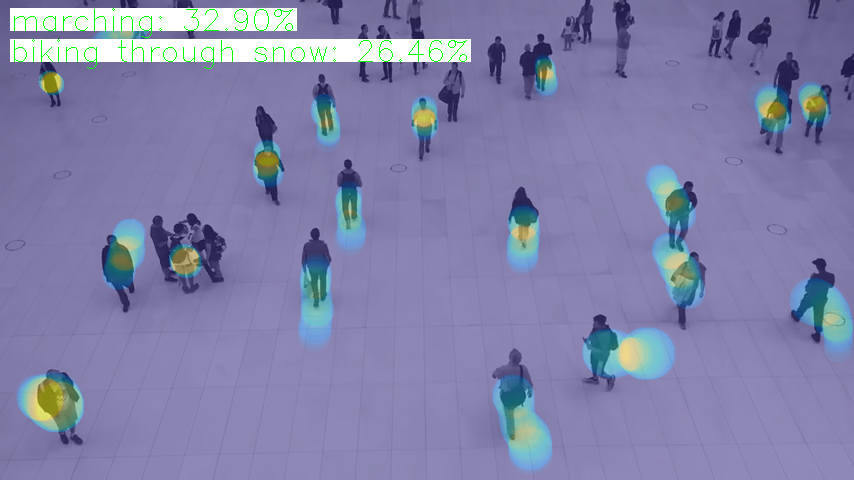


0: 384x640 19 persons, 573.6ms
Speed: 3.5ms preprocess, 573.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


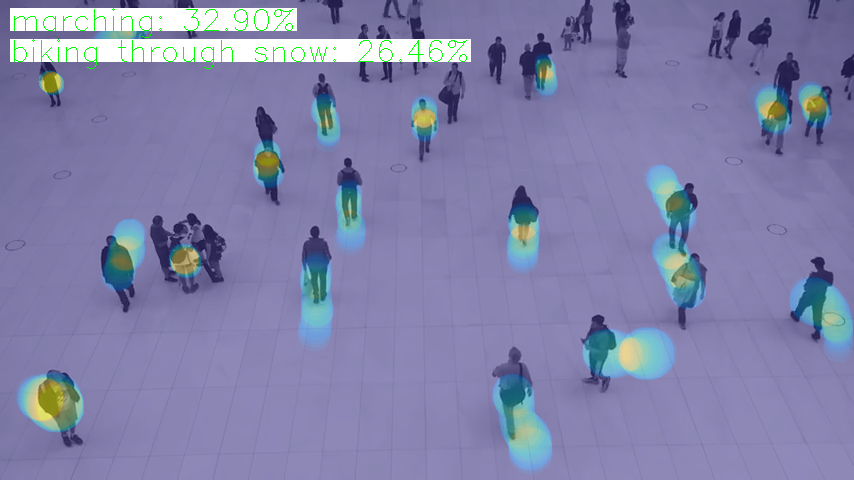


0: 384x640 19 persons, 594.2ms
Speed: 3.3ms preprocess, 594.2ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


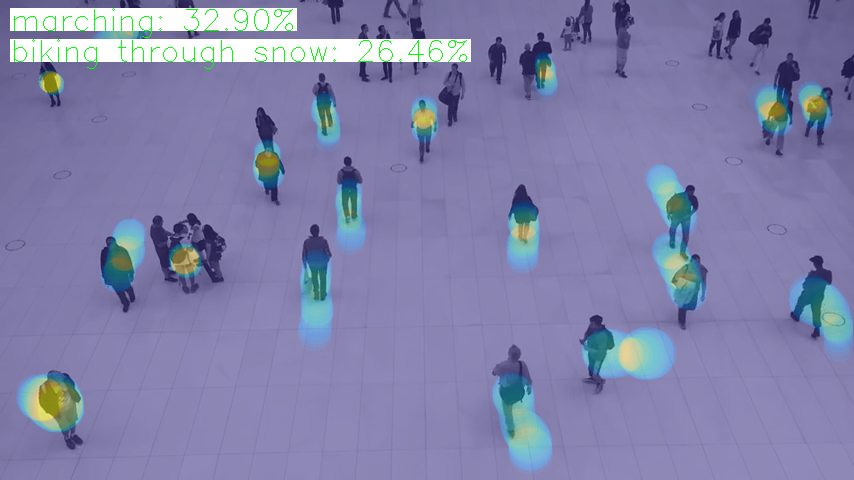


0: 384x640 19 persons, 612.2ms
Speed: 3.2ms preprocess, 612.2ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


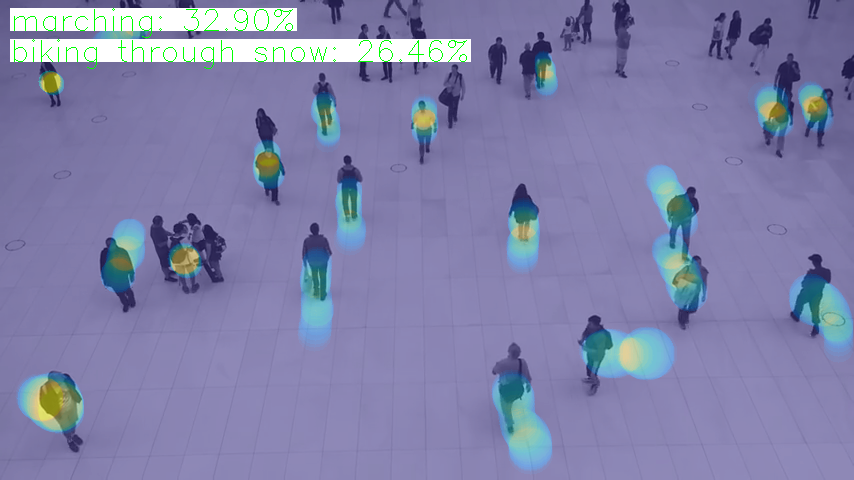


0: 384x640 19 persons, 651.7ms
Speed: 3.3ms preprocess, 651.7ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


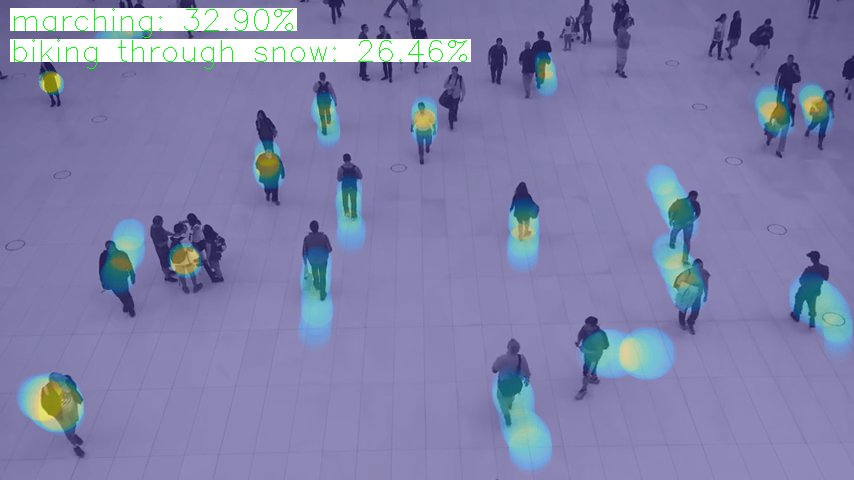


0: 384x640 19 persons, 619.7ms
Speed: 3.4ms preprocess, 619.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


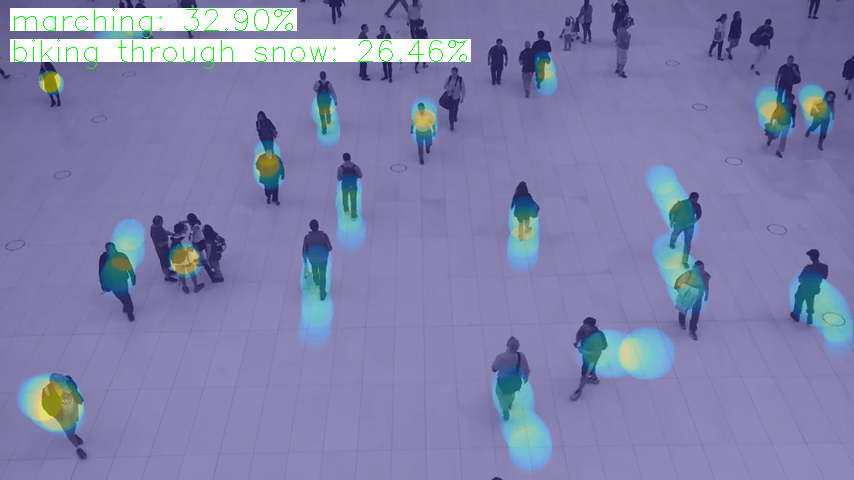


0: 384x640 20 persons, 606.2ms
Speed: 3.2ms preprocess, 606.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


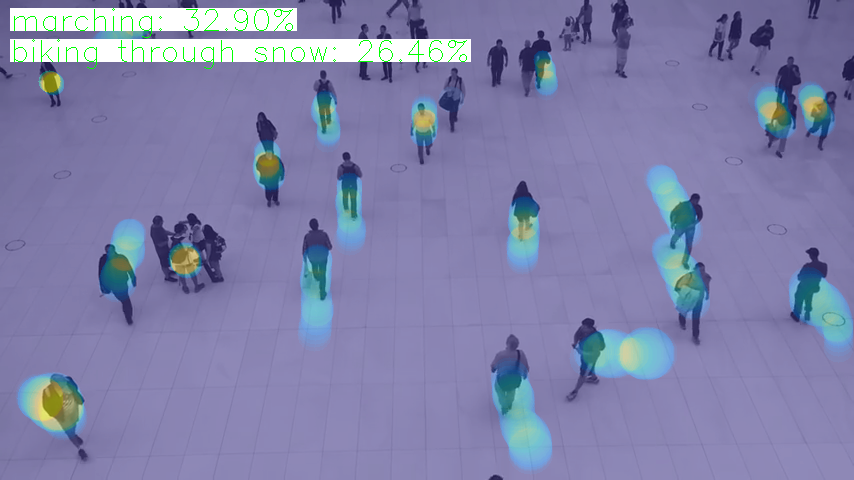


0: 384x640 20 persons, 685.8ms
Speed: 3.2ms preprocess, 685.8ms inference, 5.7ms postprocess per image at shape (1, 3, 384, 640)


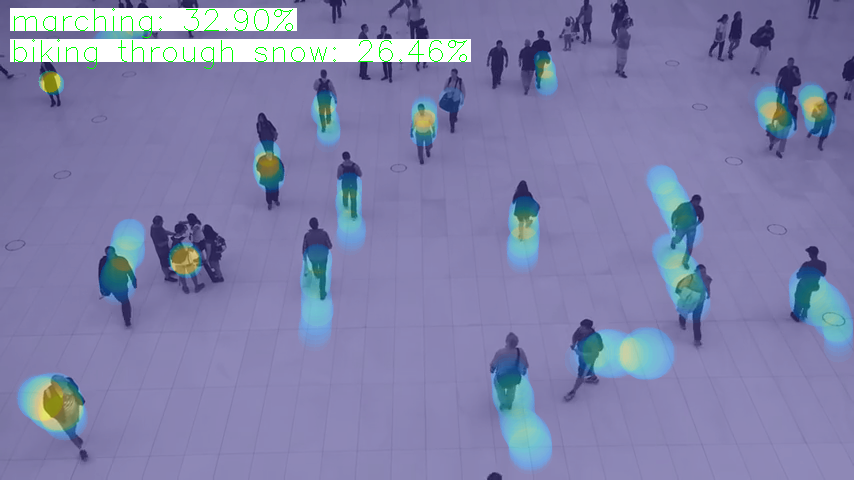


0: 384x640 20 persons, 674.3ms
Speed: 3.5ms preprocess, 674.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


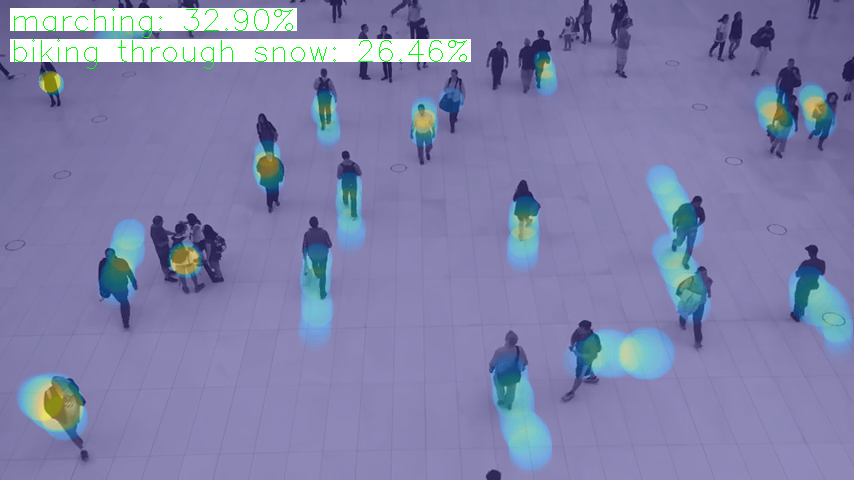


0: 384x640 20 persons, 732.0ms
Speed: 3.6ms preprocess, 732.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


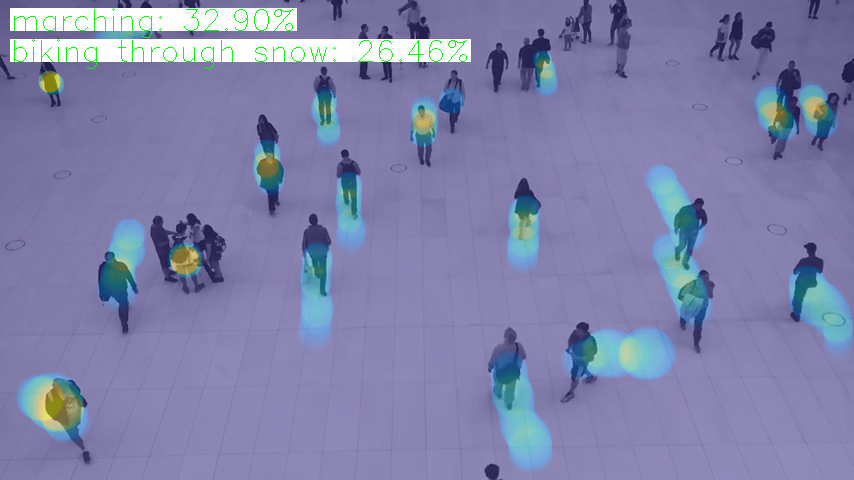


0: 384x640 20 persons, 609.0ms
Speed: 6.8ms preprocess, 609.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


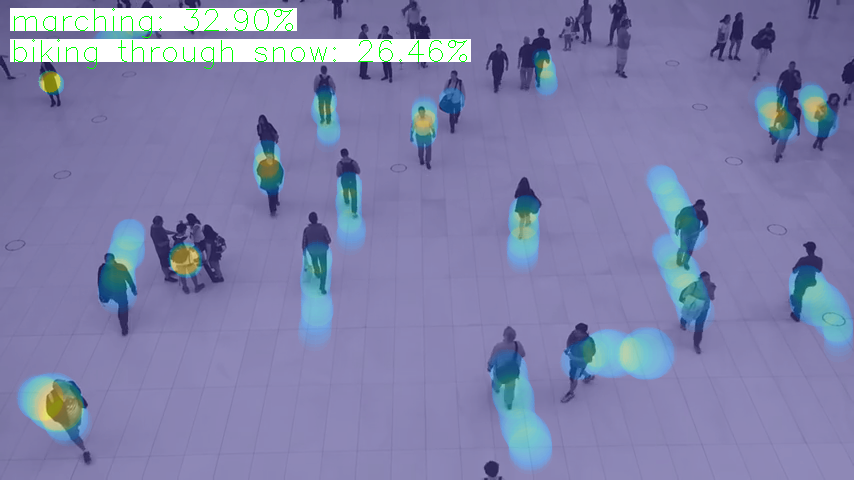


0: 384x640 20 persons, 587.1ms
Speed: 3.3ms preprocess, 587.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


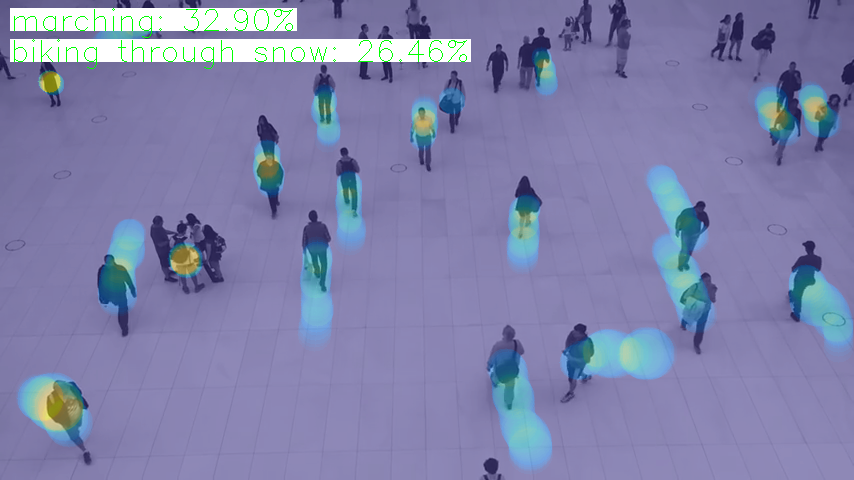


0: 384x640 20 persons, 575.0ms
Speed: 3.4ms preprocess, 575.0ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


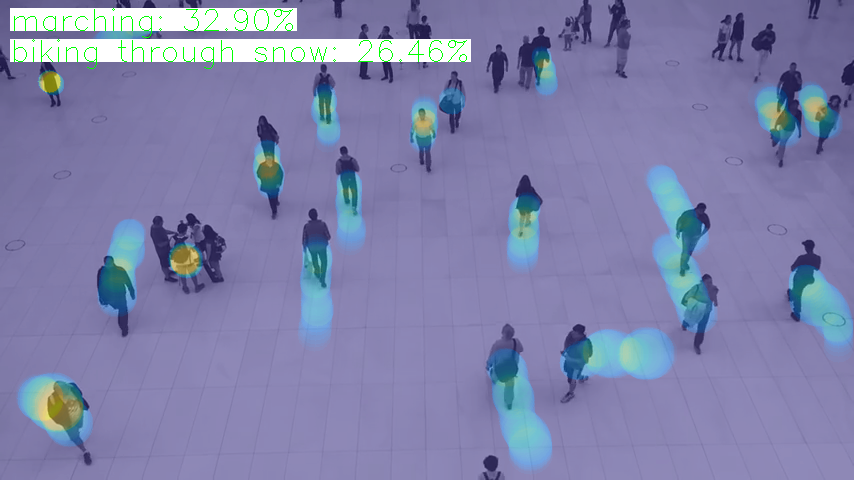


0: 384x640 20 persons, 560.2ms
Speed: 3.5ms preprocess, 560.2ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


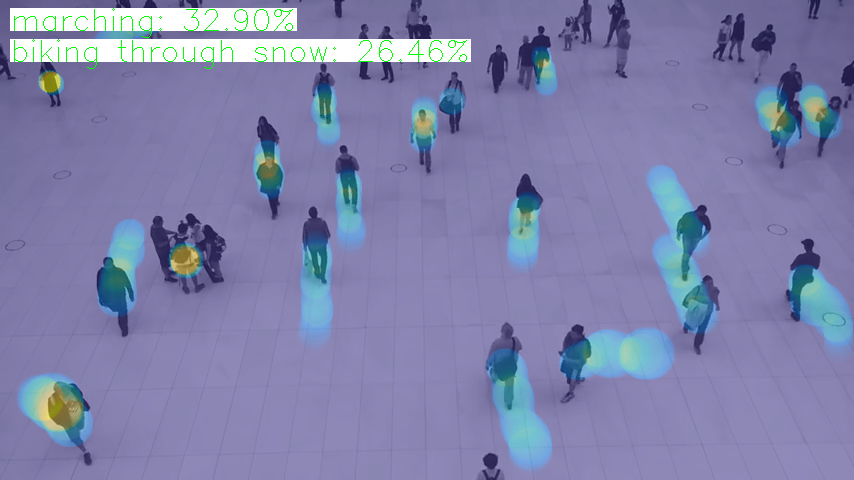


0: 384x640 20 persons, 565.6ms
Speed: 3.4ms preprocess, 565.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


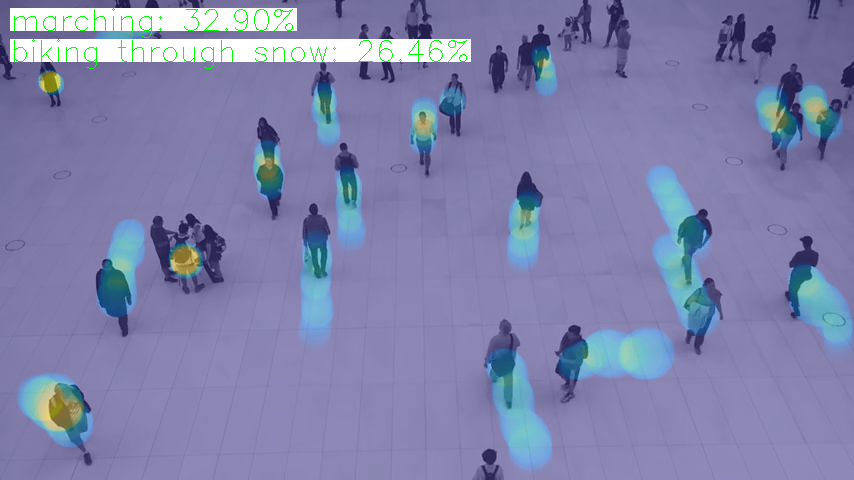


0: 384x640 21 persons, 630.5ms
Speed: 3.3ms preprocess, 630.5ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


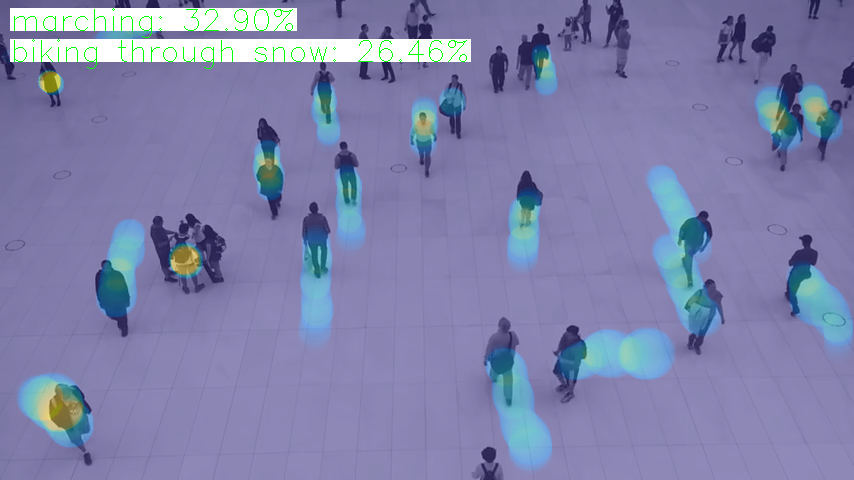


0: 384x640 21 persons, 582.9ms
Speed: 3.8ms preprocess, 582.9ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


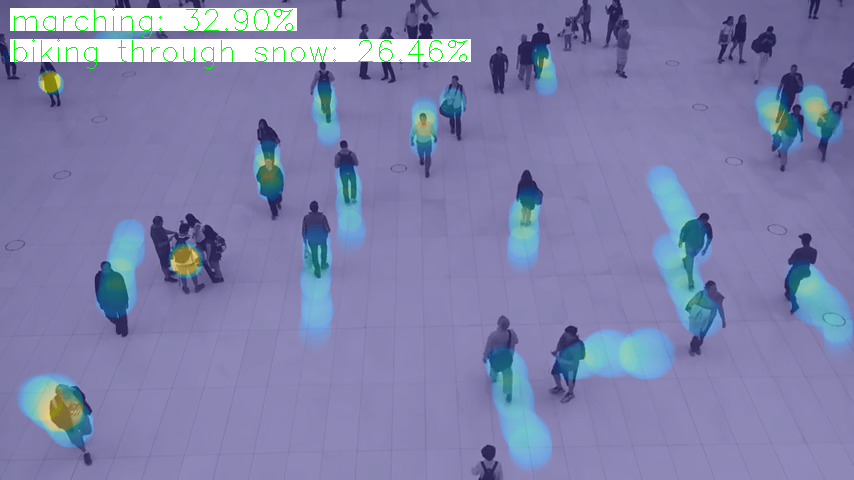


0: 384x640 21 persons, 587.3ms
Speed: 3.4ms preprocess, 587.3ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


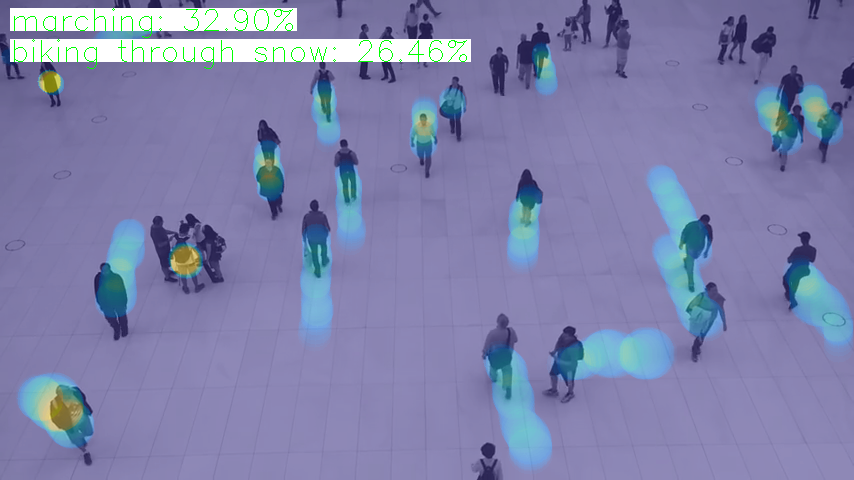


0: 384x640 20 persons, 1 suitcase, 570.5ms
Speed: 3.4ms preprocess, 570.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


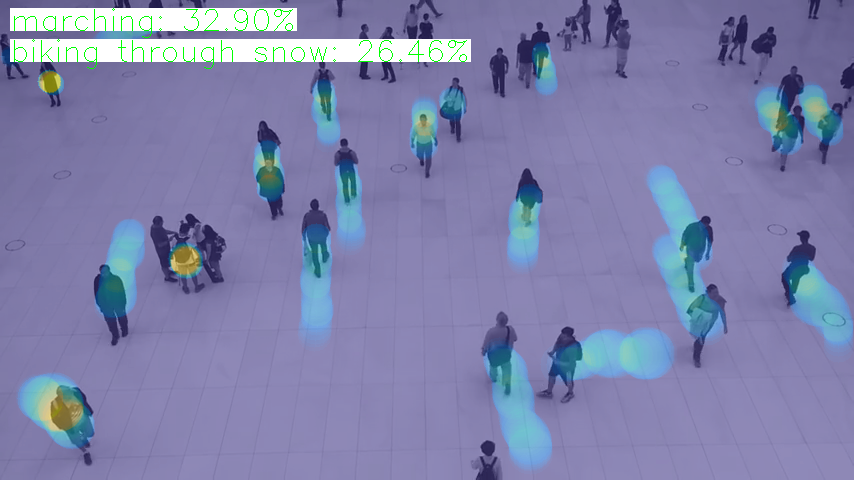


0: 384x640 20 persons, 1 suitcase, 566.6ms
Speed: 3.4ms preprocess, 566.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


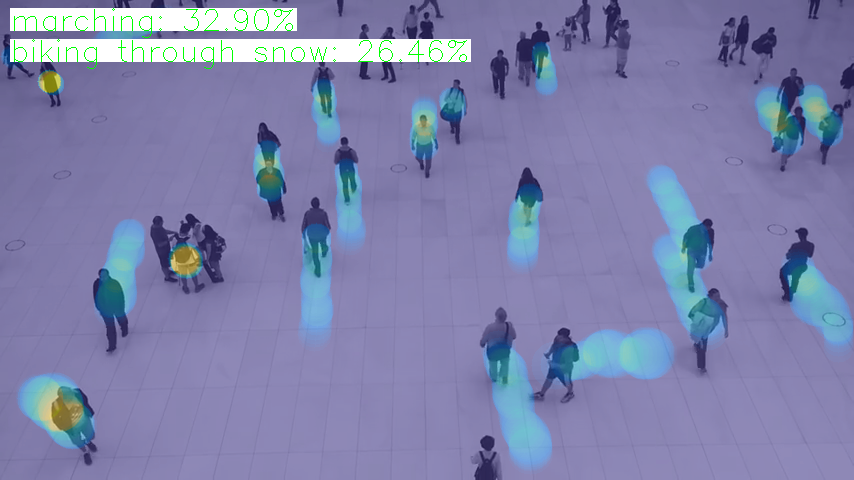


0: 384x640 22 persons, 593.5ms
Speed: 3.4ms preprocess, 593.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


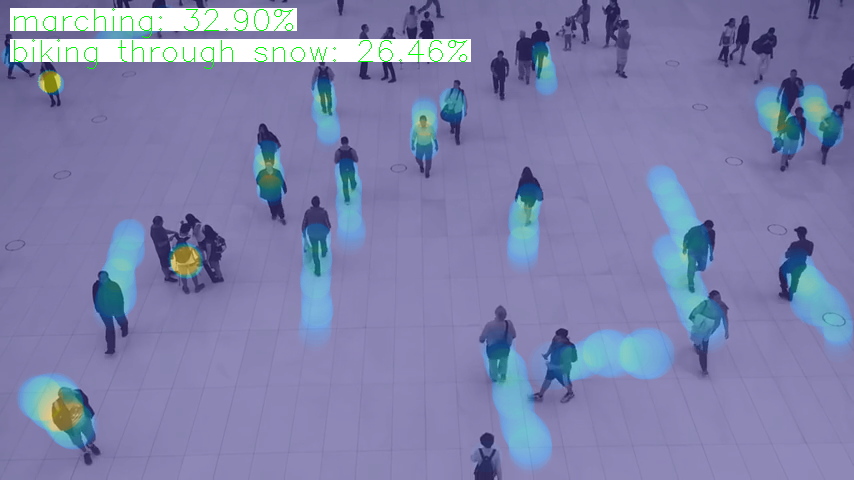


0: 384x640 22 persons, 650.1ms
Speed: 3.3ms preprocess, 650.1ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


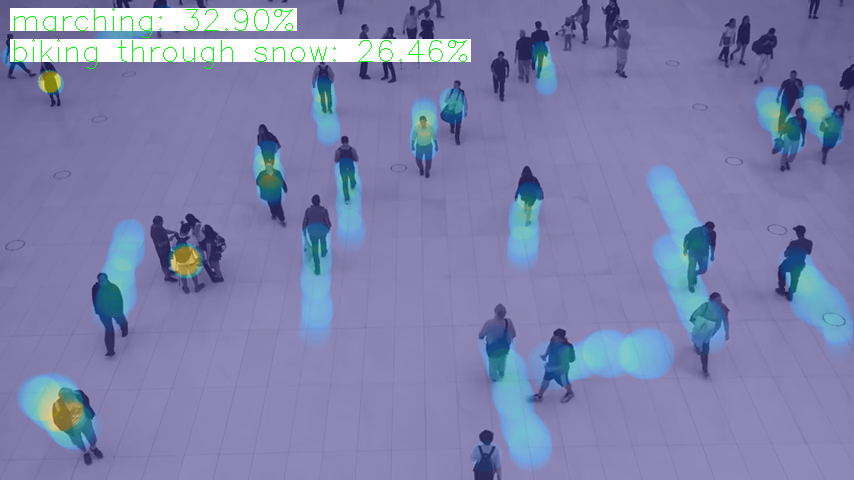


0: 384x640 22 persons, 660.8ms
Speed: 3.4ms preprocess, 660.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


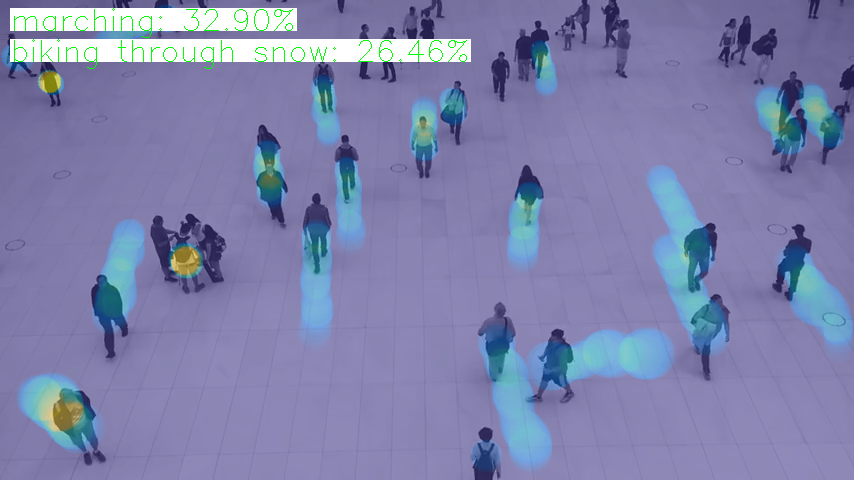


0: 384x640 22 persons, 597.4ms
Speed: 3.3ms preprocess, 597.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


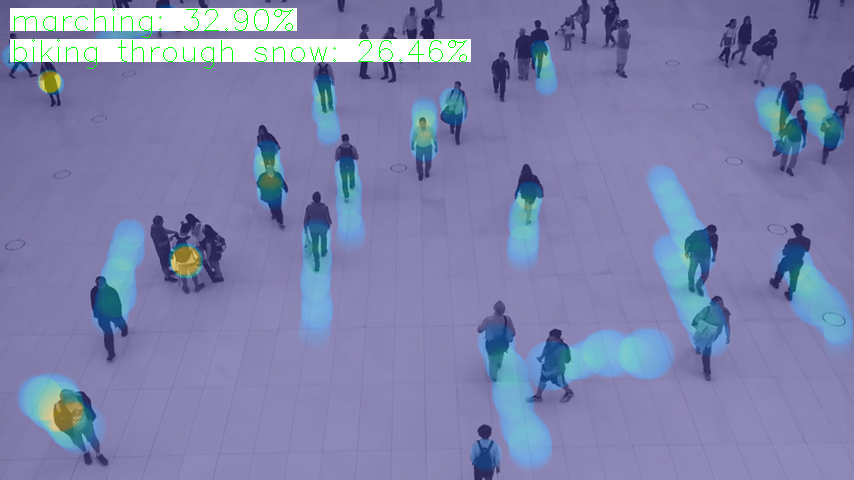


0: 384x640 22 persons, 560.8ms
Speed: 3.3ms preprocess, 560.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


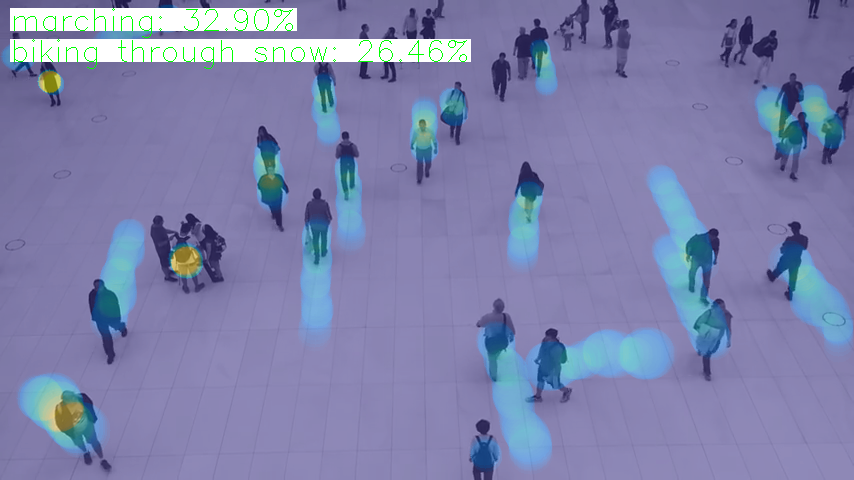


0: 384x640 22 persons, 647.6ms
Speed: 3.2ms preprocess, 647.6ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)


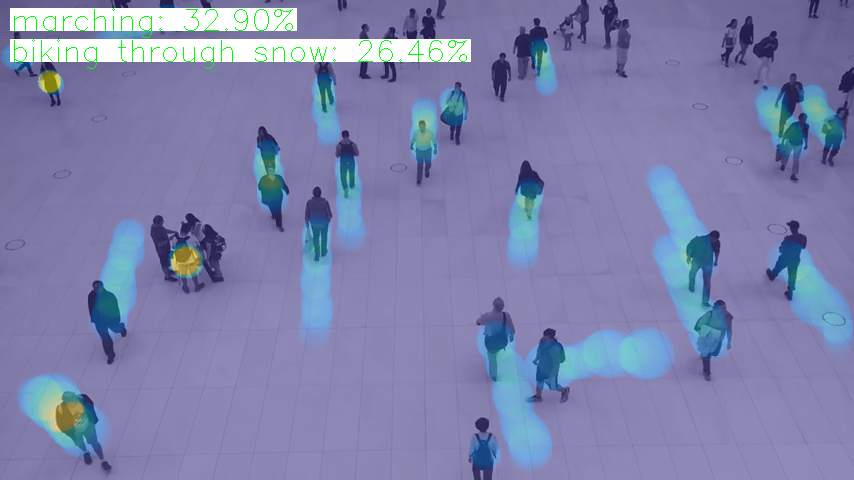


0: 384x640 22 persons, 715.4ms
Speed: 3.5ms preprocess, 715.4ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


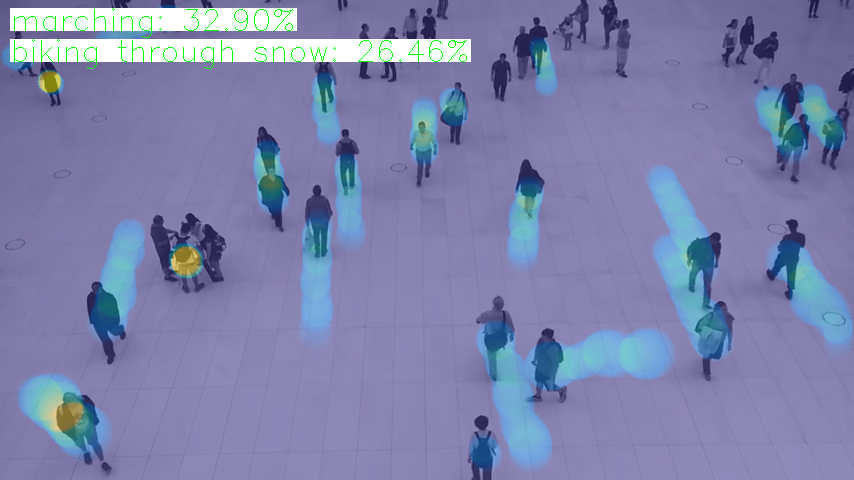


0: 384x640 22 persons, 728.5ms
Speed: 4.0ms preprocess, 728.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


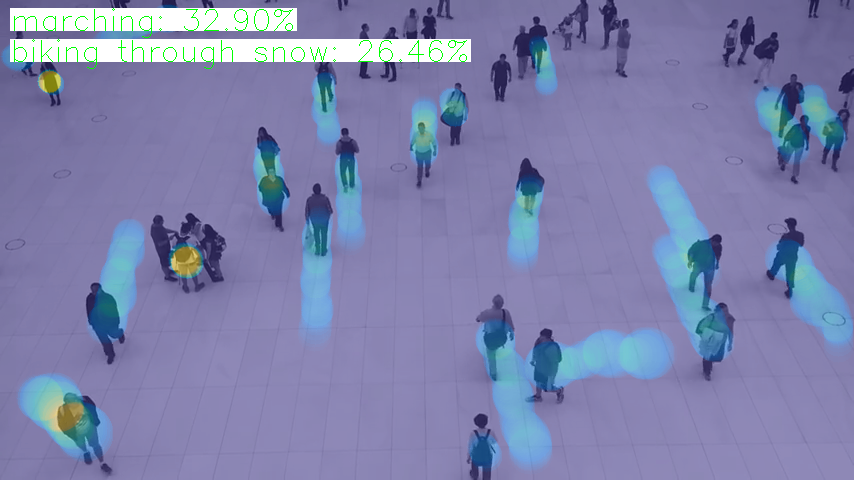


0: 384x640 22 persons, 584.1ms
Speed: 3.4ms preprocess, 584.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


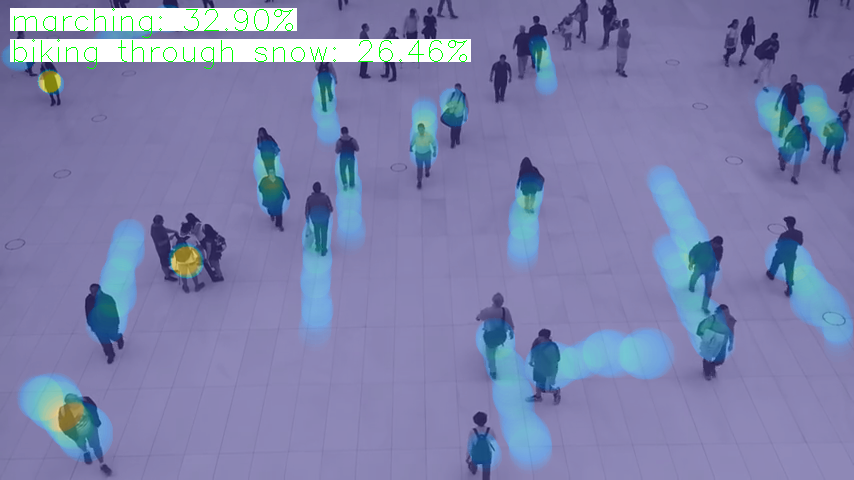


0: 384x640 23 persons, 597.7ms
Speed: 3.6ms preprocess, 597.7ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)


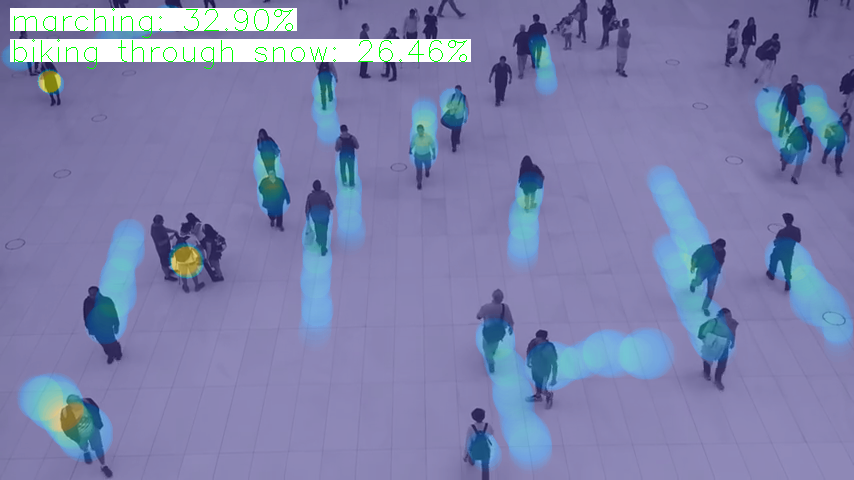


0: 384x640 23 persons, 584.1ms
Speed: 3.5ms preprocess, 584.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


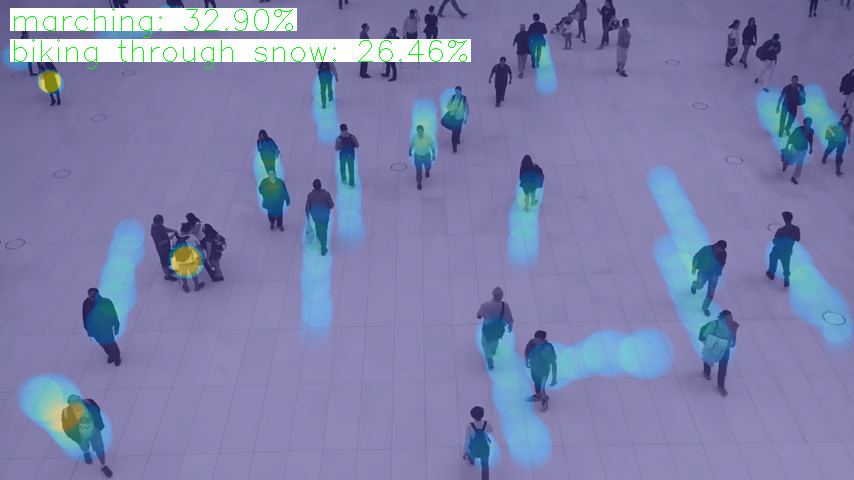


0: 384x640 24 persons, 616.1ms
Speed: 3.2ms preprocess, 616.1ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)


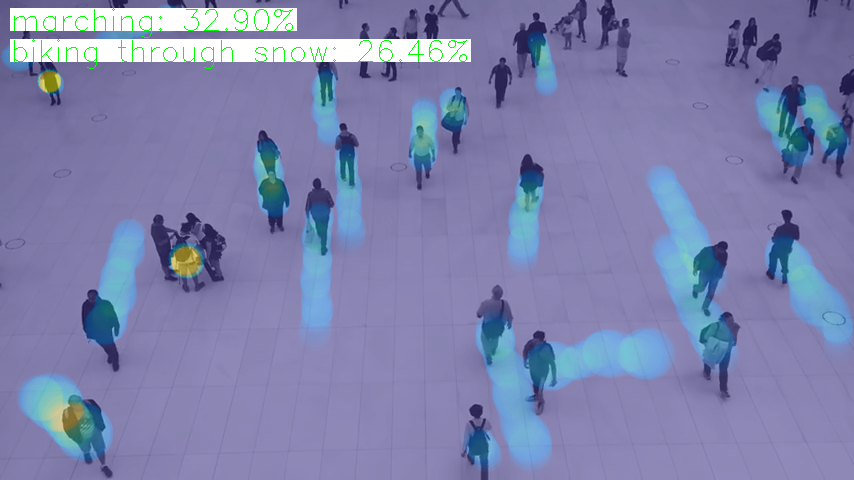


0: 384x640 24 persons, 565.8ms
Speed: 3.6ms preprocess, 565.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


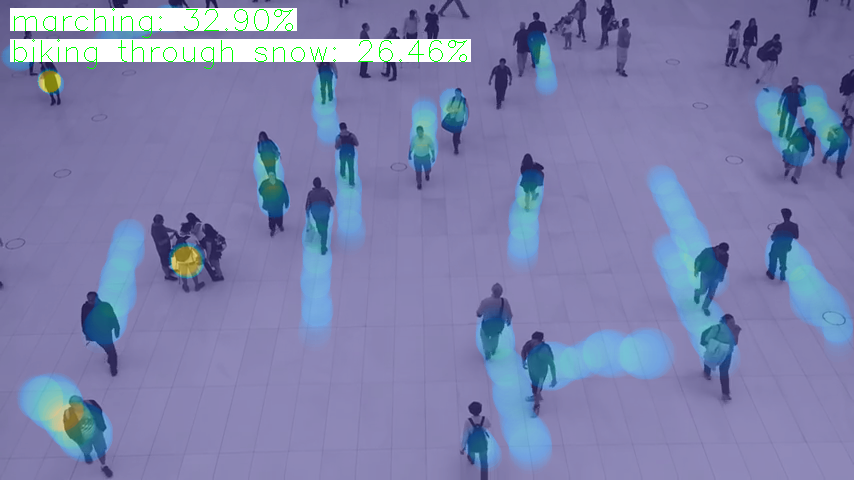


0: 384x640 24 persons, 584.6ms
Speed: 3.4ms preprocess, 584.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


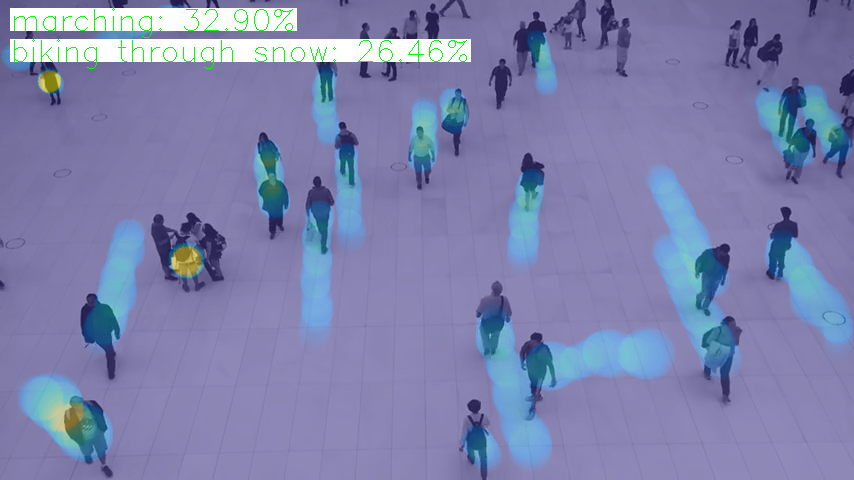


0: 384x640 24 persons, 589.3ms
Speed: 3.4ms preprocess, 589.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


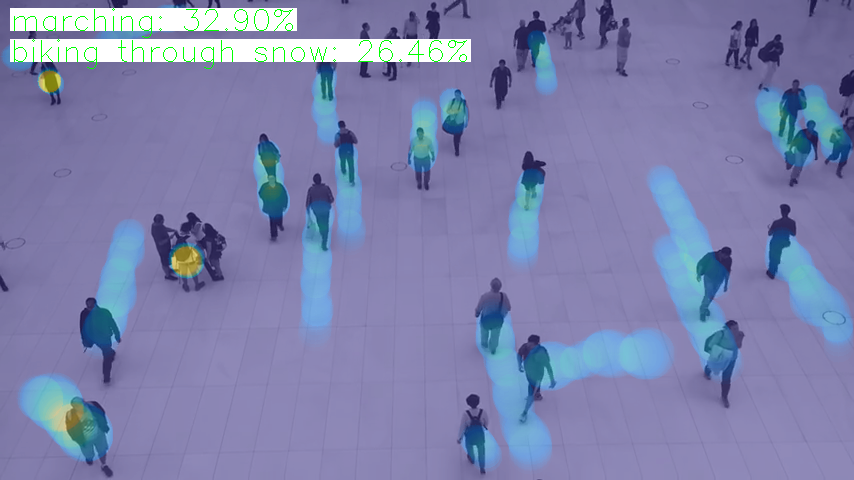


0: 384x640 24 persons, 604.2ms
Speed: 3.5ms preprocess, 604.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


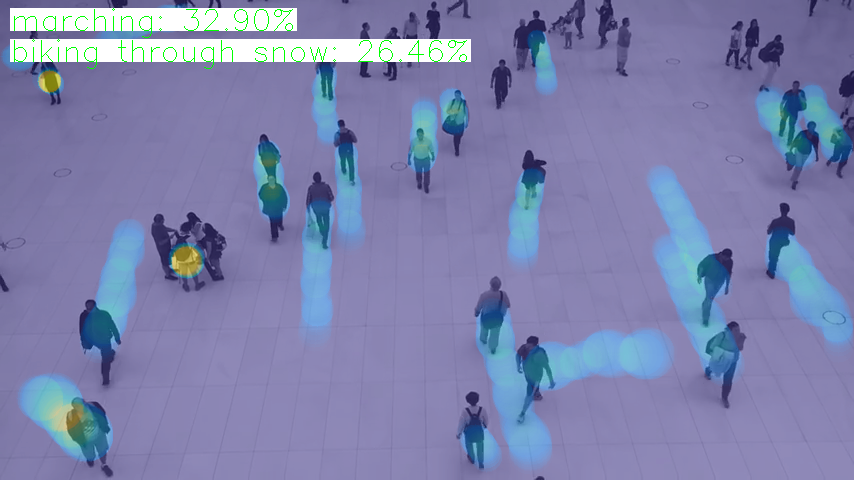


0: 384x640 25 persons, 610.2ms
Speed: 3.3ms preprocess, 610.2ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)


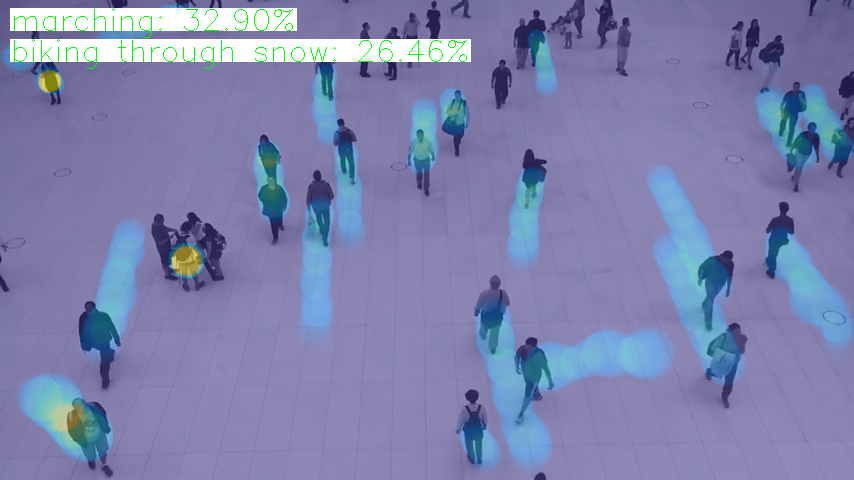


0: 384x640 24 persons, 561.7ms
Speed: 3.6ms preprocess, 561.7ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


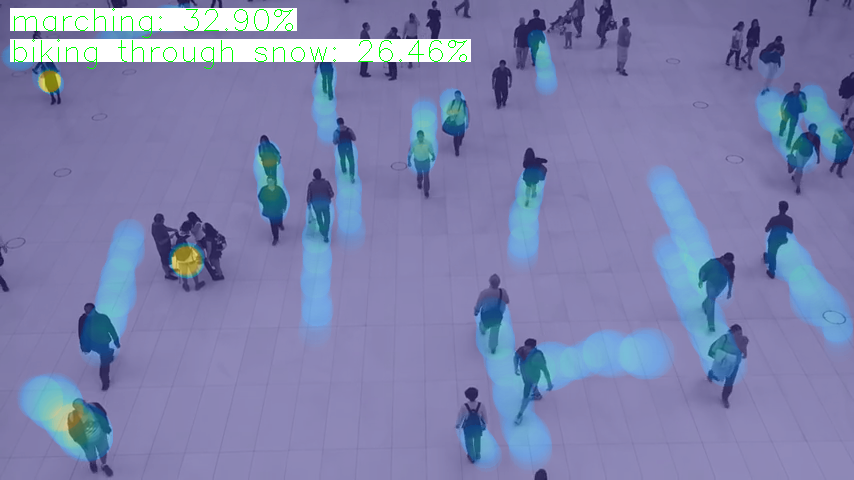


0: 384x640 24 persons, 568.1ms
Speed: 3.4ms preprocess, 568.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


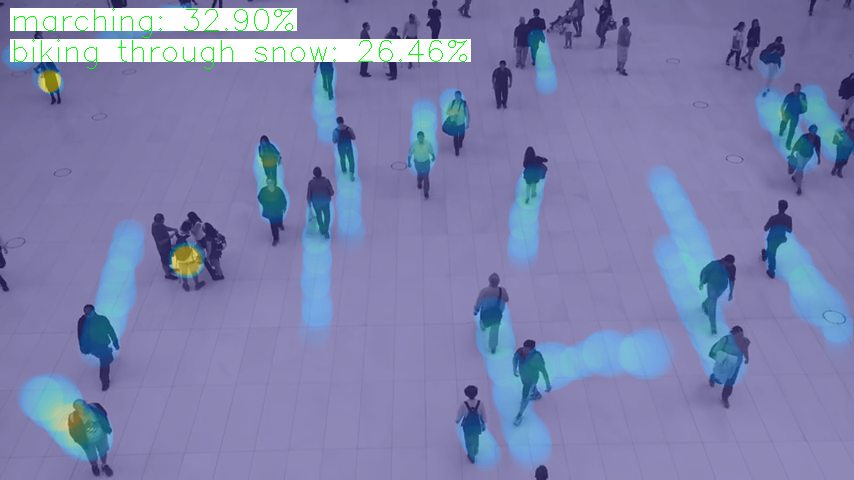


0: 384x640 24 persons, 667.4ms
Speed: 3.2ms preprocess, 667.4ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


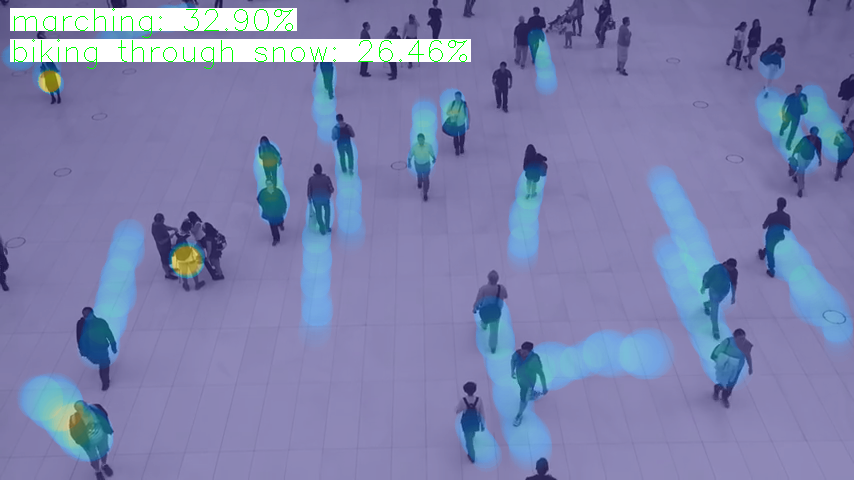


0: 384x640 24 persons, 667.1ms
Speed: 4.0ms preprocess, 667.1ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


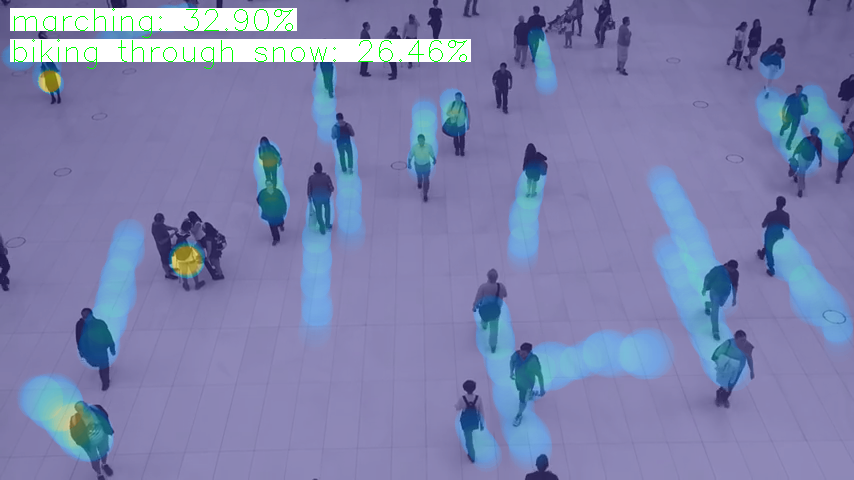


0: 384x640 24 persons, 646.4ms
Speed: 3.8ms preprocess, 646.4ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


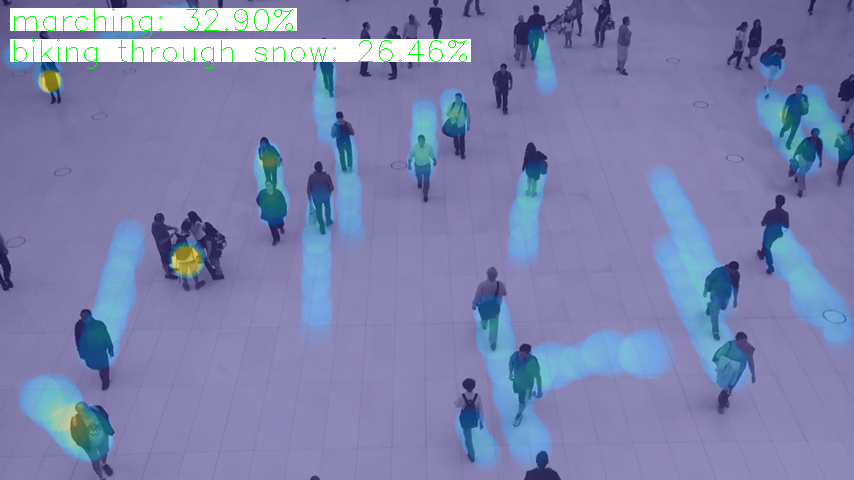


0: 384x640 25 persons, 631.6ms
Speed: 3.2ms preprocess, 631.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


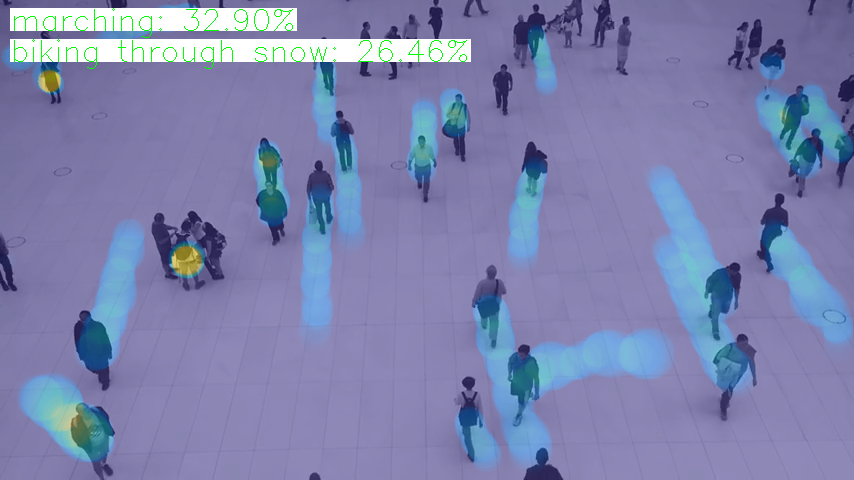


0: 384x640 25 persons, 640.7ms
Speed: 3.4ms preprocess, 640.7ms inference, 5.5ms postprocess per image at shape (1, 3, 384, 640)


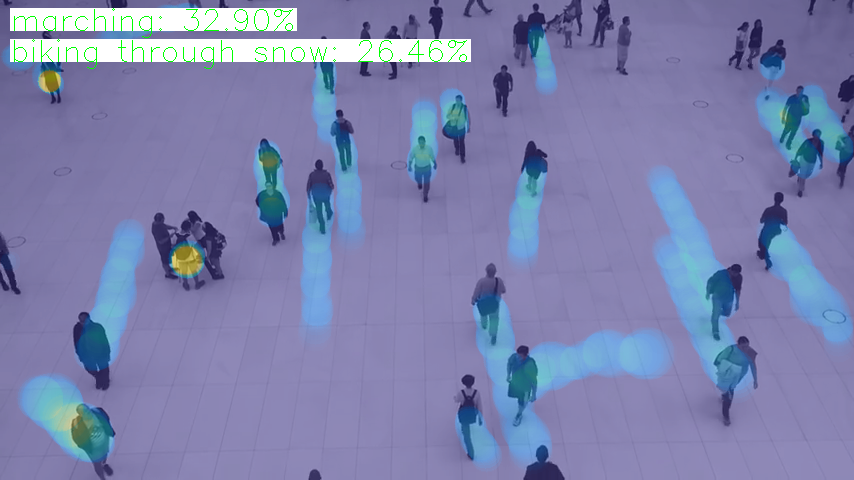


0: 384x640 25 persons, 1 dog, 737.8ms
Speed: 3.4ms preprocess, 737.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


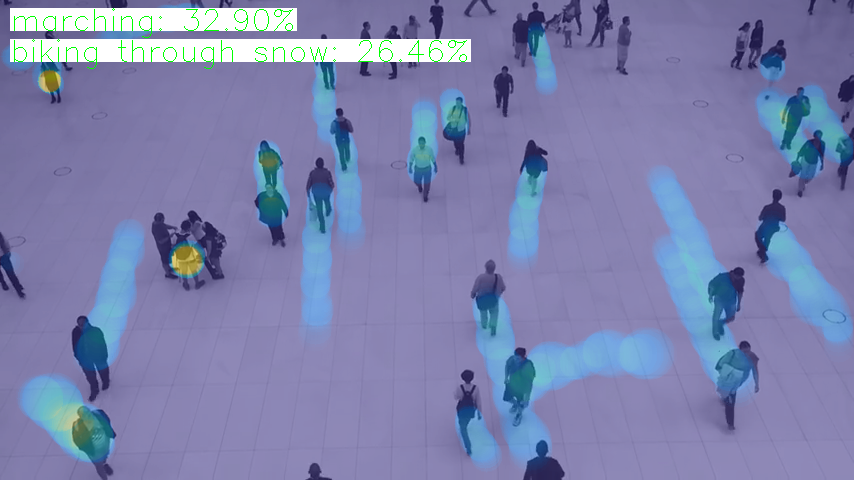


0: 384x640 26 persons, 616.6ms
Speed: 6.2ms preprocess, 616.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


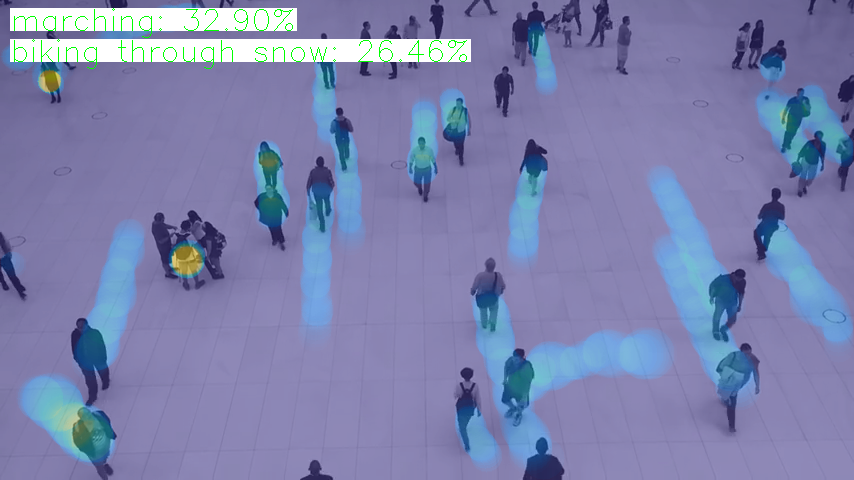


0: 384x640 27 persons, 577.6ms
Speed: 3.3ms preprocess, 577.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


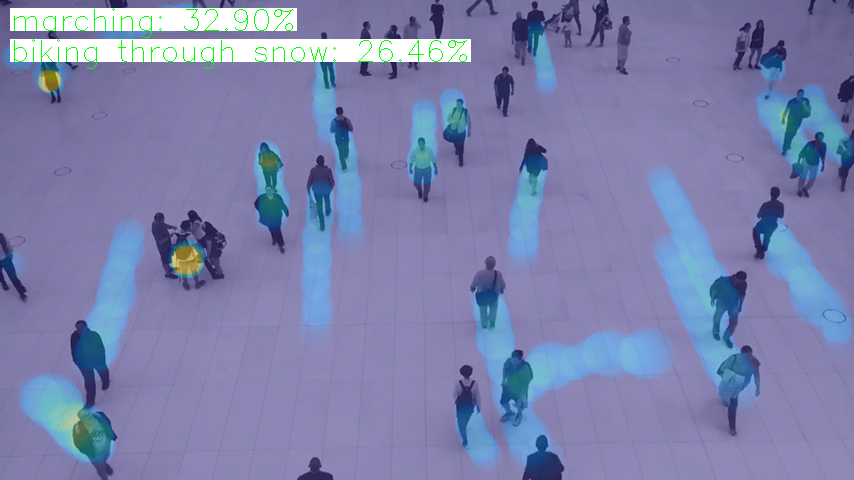


0: 384x640 27 persons, 572.0ms
Speed: 3.7ms preprocess, 572.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


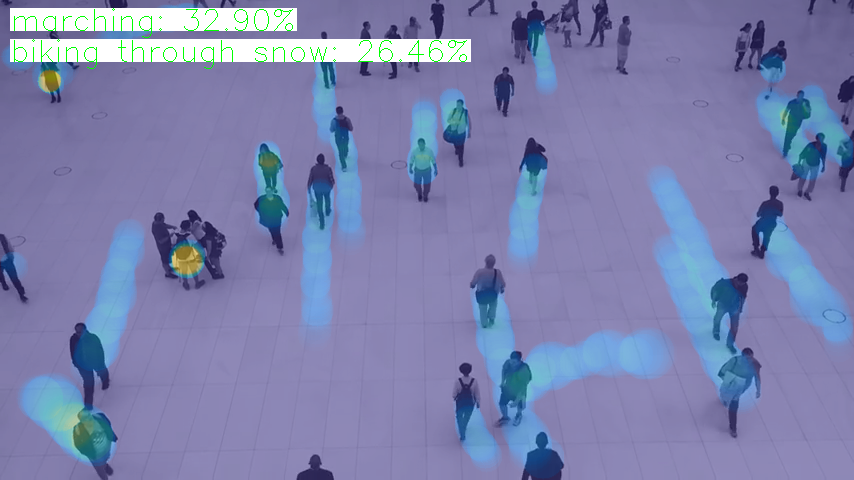


0: 384x640 27 persons, 593.0ms
Speed: 3.2ms preprocess, 593.0ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


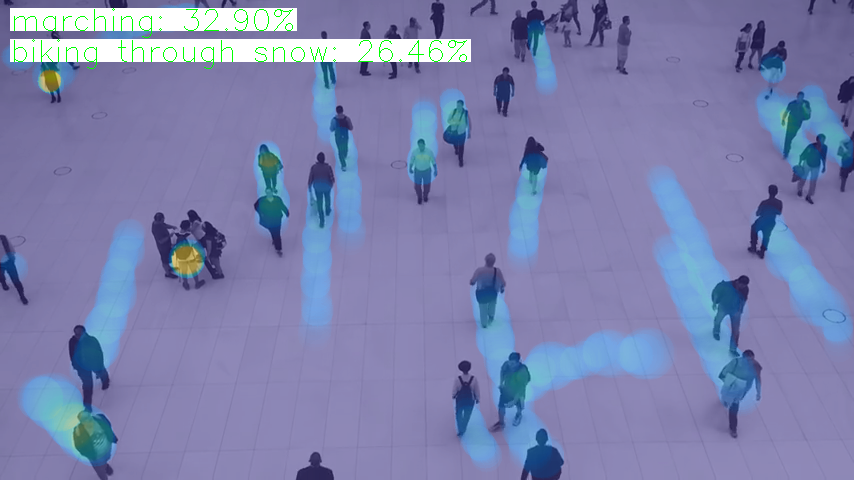


0: 384x640 28 persons, 597.8ms
Speed: 3.7ms preprocess, 597.8ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


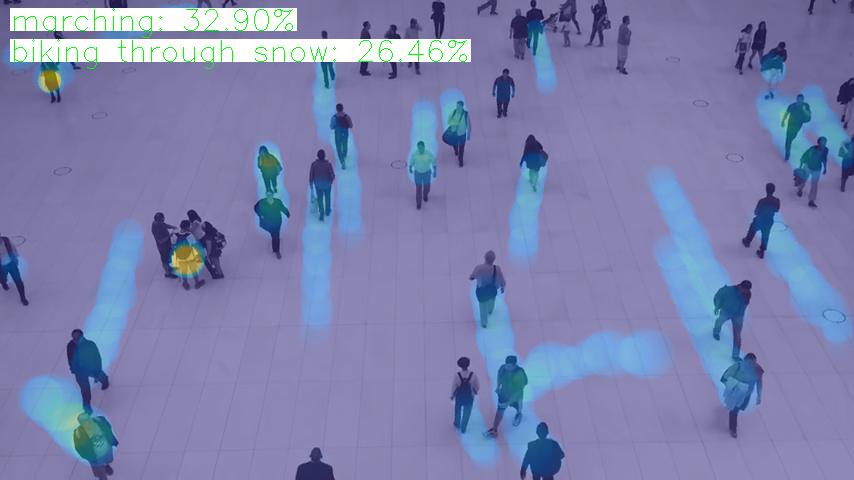


0: 384x640 28 persons, 582.1ms
Speed: 3.4ms preprocess, 582.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


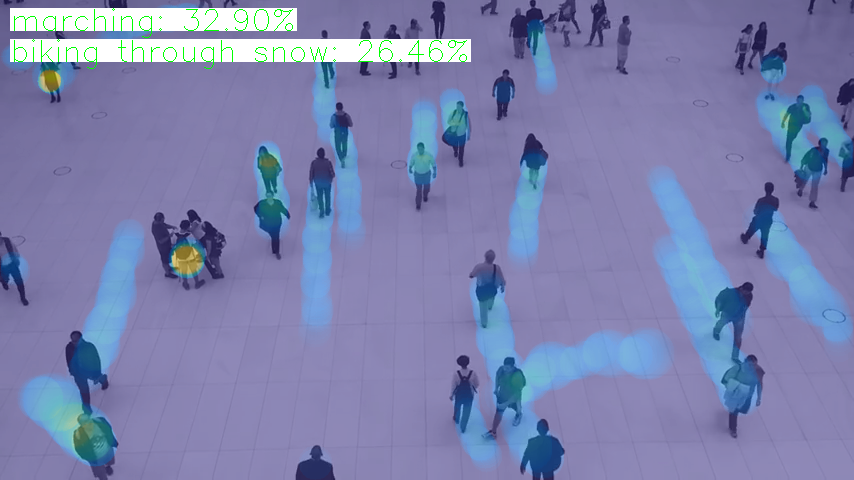


0: 384x640 28 persons, 583.6ms
Speed: 3.5ms preprocess, 583.6ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


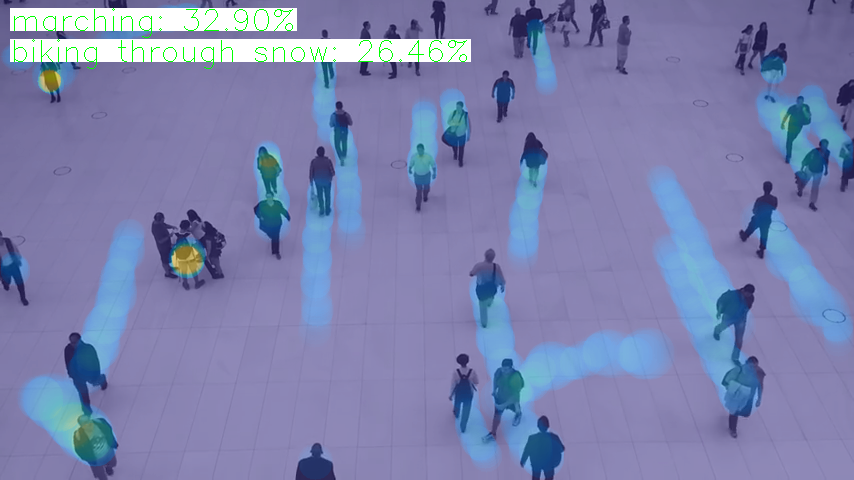


0: 384x640 26 persons, 1 dog, 1 suitcase, 567.8ms
Speed: 3.4ms preprocess, 567.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


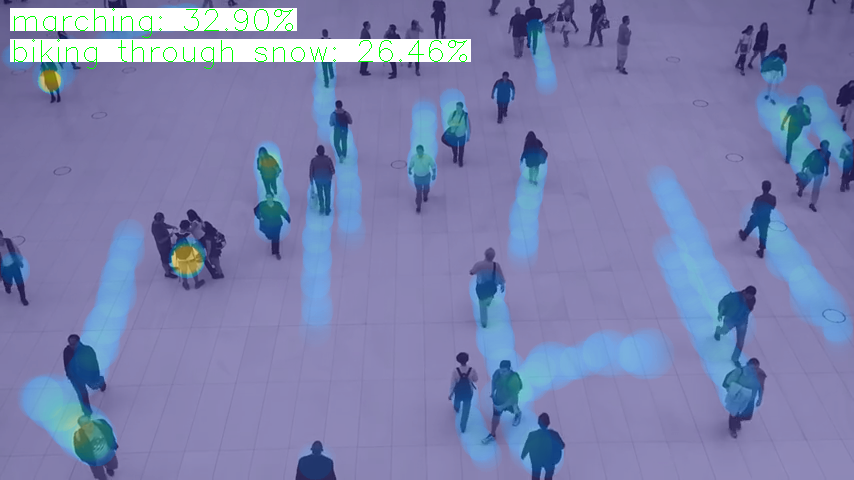


0: 384x640 28 persons, 579.0ms
Speed: 3.5ms preprocess, 579.0ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


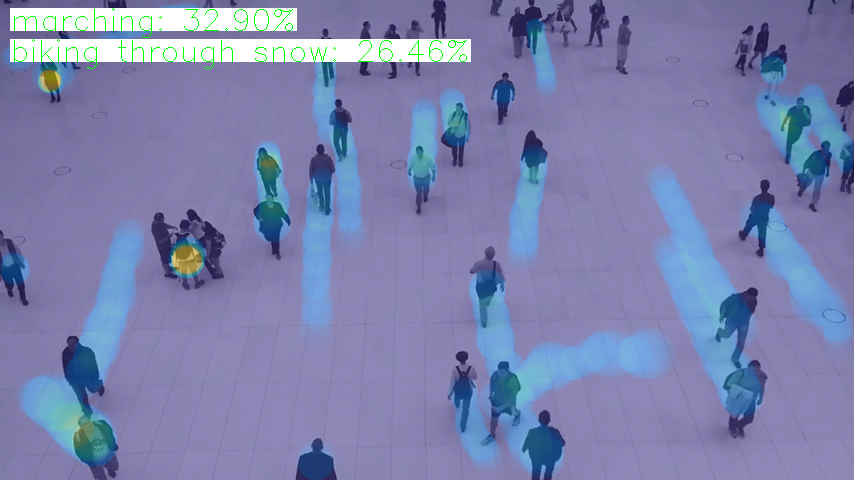


0: 384x640 28 persons, 595.8ms
Speed: 3.3ms preprocess, 595.8ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)


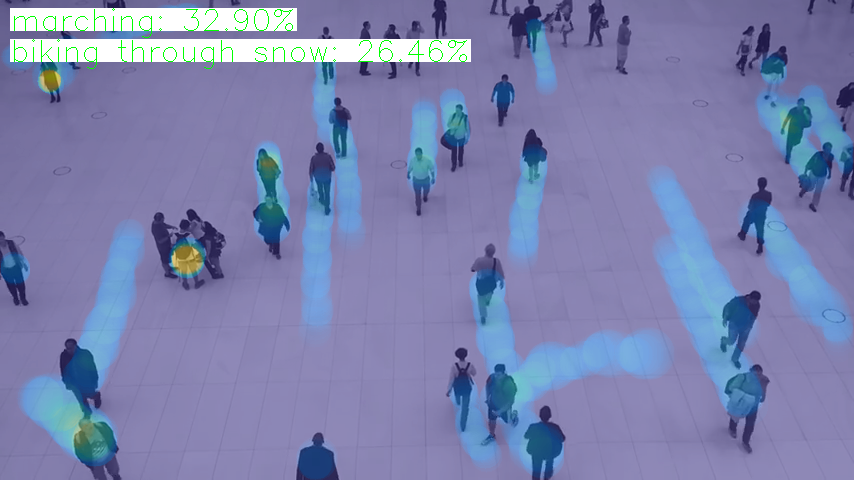


0: 384x640 28 persons, 581.8ms
Speed: 3.7ms preprocess, 581.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


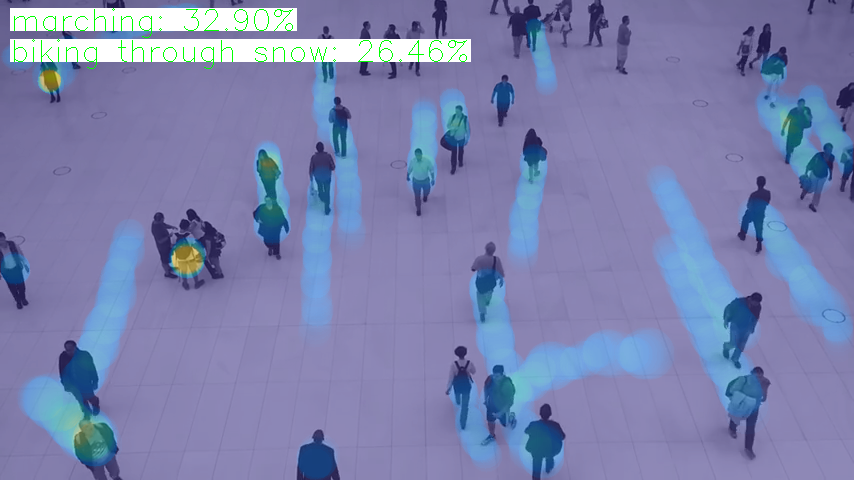


0: 384x640 28 persons, 592.7ms
Speed: 3.2ms preprocess, 592.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


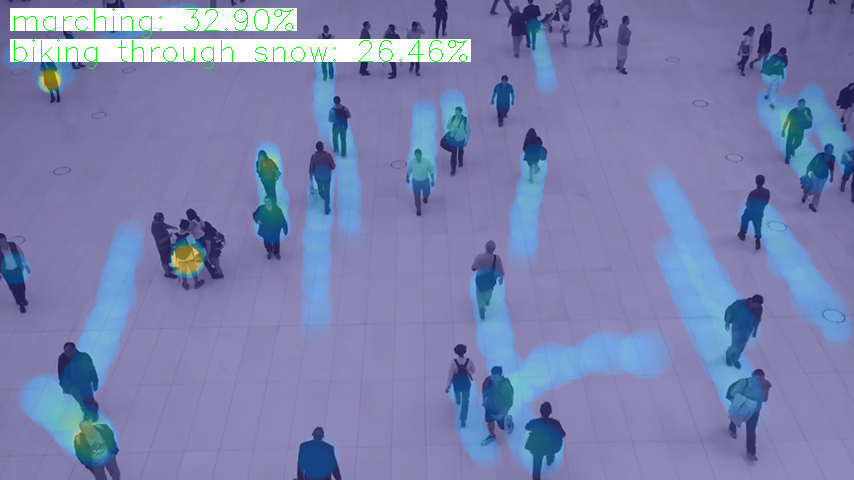


0: 384x640 28 persons, 616.6ms
Speed: 3.4ms preprocess, 616.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)


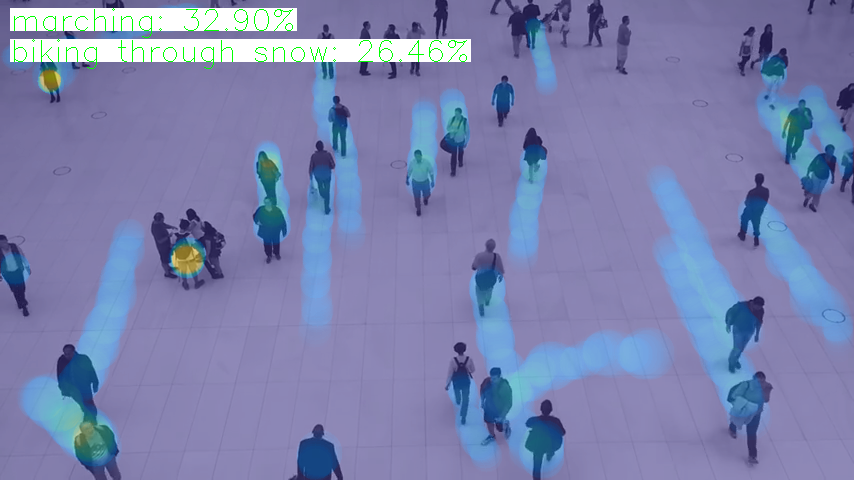


0: 384x640 28 persons, 573.0ms
Speed: 3.4ms preprocess, 573.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


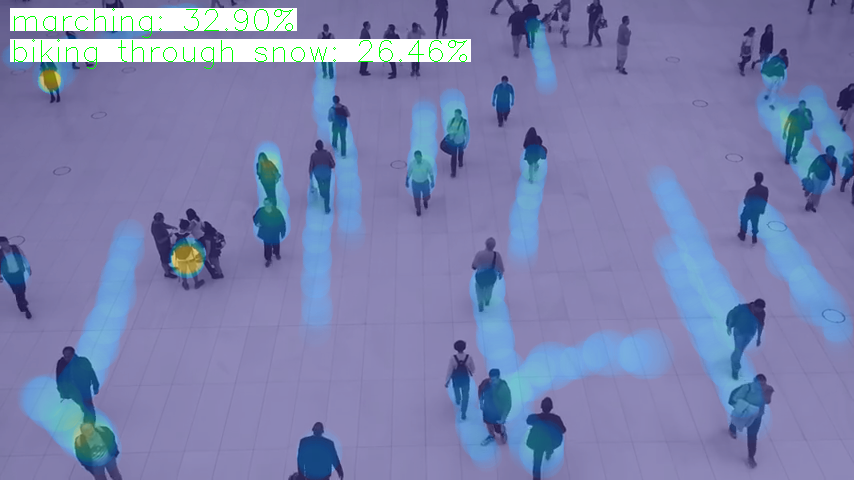


0: 384x640 28 persons, 625.2ms
Speed: 4.1ms preprocess, 625.2ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)


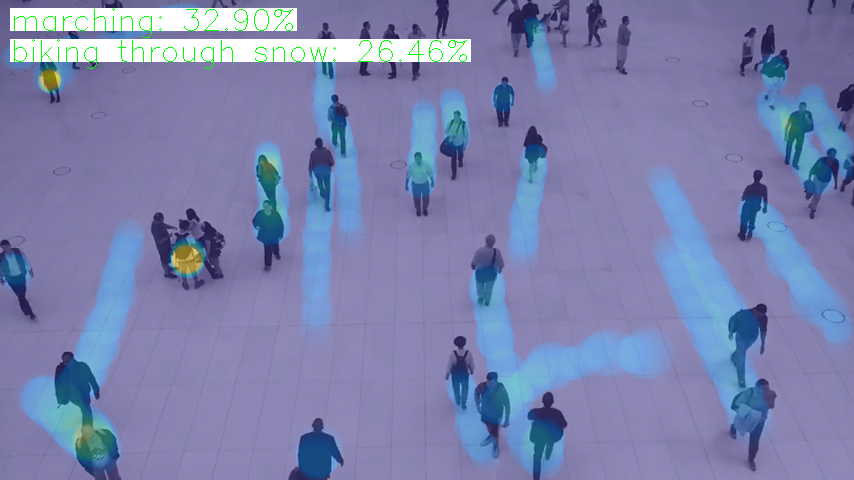


0: 384x640 28 persons, 715.8ms
Speed: 3.5ms preprocess, 715.8ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)


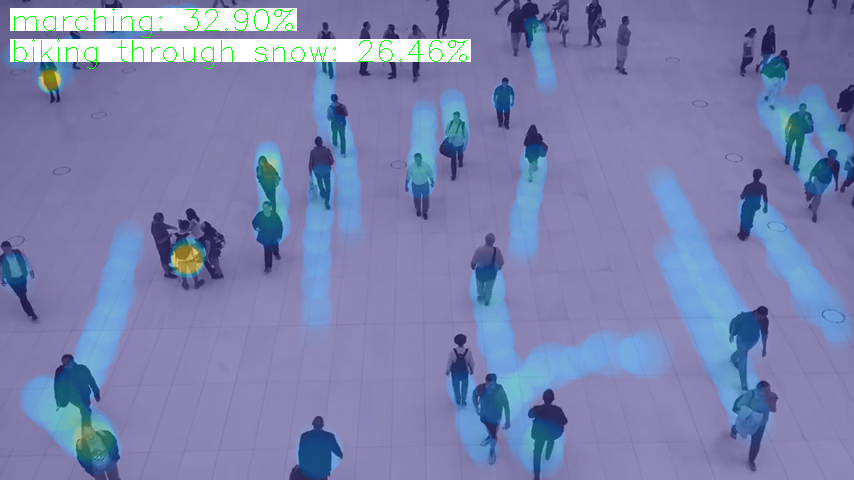


0: 384x640 28 persons, 714.0ms
Speed: 4.1ms preprocess, 714.0ms inference, 4.0ms postprocess per image at shape (1, 3, 384, 640)


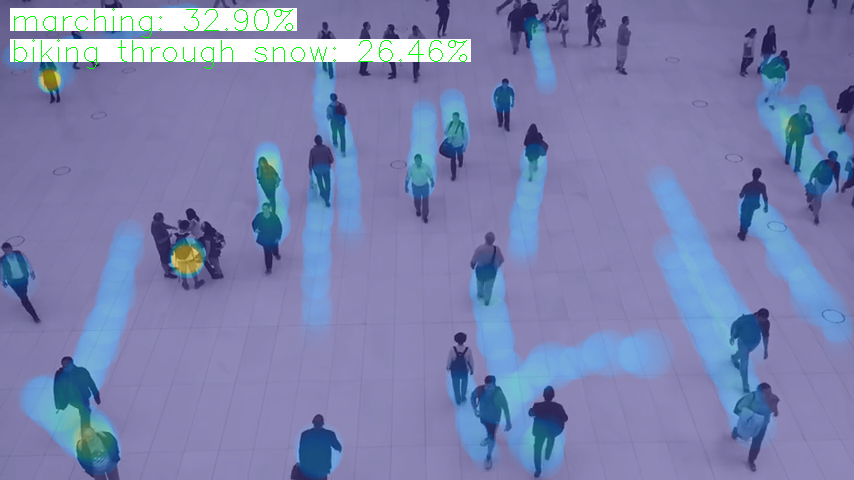


0: 384x640 28 persons, 635.9ms
Speed: 3.4ms preprocess, 635.9ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


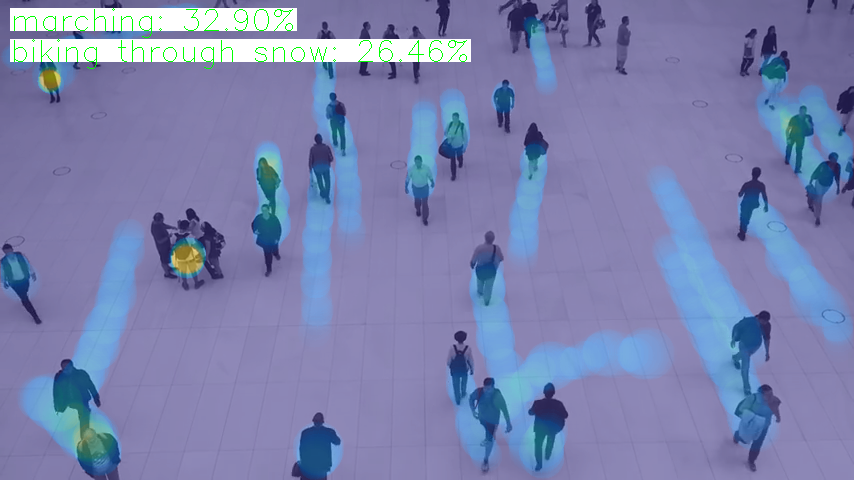


0: 384x640 28 persons, 615.2ms
Speed: 6.0ms preprocess, 615.2ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


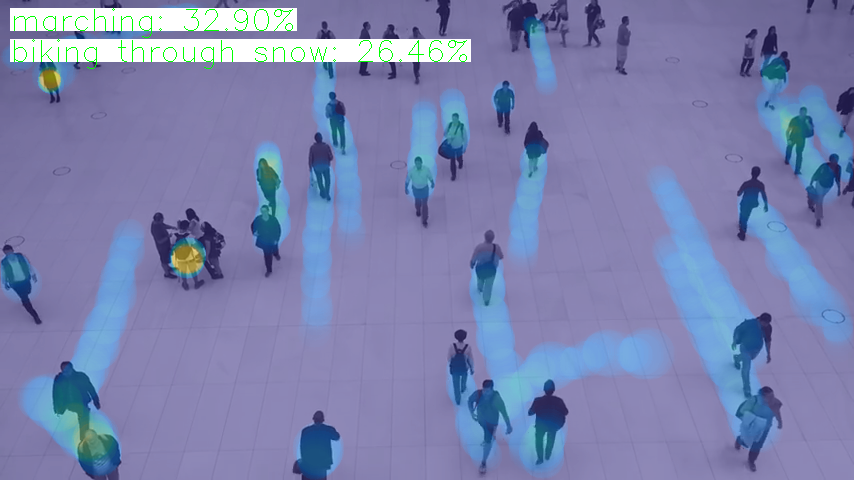


0: 384x640 27 persons, 578.5ms
Speed: 3.5ms preprocess, 578.5ms inference, 2.5ms postprocess per image at shape (1, 3, 384, 640)


In [ ]:
predictAndAnalyseBehaviour(sampleVideo)